In [1]:
# from google.colab import drive
# drive.mount('/content/drive')

# データ読み込み

In [1]:
import sys
import csv
import copy
from tqdm import tqdm
import gc
import pickle

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline

from tqdm import tqdm
import tensorflow as tf
from tensorflow.keras.callbacks import EarlyStopping, LearningRateScheduler, ReduceLROnPlateau, ModelCheckpoint
from tensorflow.keras import backend as K
from tensorflow.keras.layers import Input, Flatten, Lambda
from tensorflow.keras.applications.vgg16 import VGG16
#from tensorflow.keras.applications.xception import Xception
from tensorflow.keras.models import Model, load_model
from tensorflow.keras.layers import Dense, Embedding, LSTM
from tensorflow.keras.layers import Reshape, Activation, concatenate, dot, BatchNormalization, GlobalAveragePooling2D
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.model_selection import train_test_split
from functools import partial
np.load = partial(np.load, allow_pickle=True)  # monkey patch

SEED=9999


In [2]:
def load_data():
    def load_pickle(path):
        with open(path, 'rb') as handle:
          return pickle.load(handle)

    # 学習データ
    x_train = np.load('/root/userspace/final/train_img.npz')['arr_0']
    y_train = np.load('/root/userspace/final/y_train.npy')
    tokenizer = load_pickle('/root/userspace/final/tokenizer.pickle')
    # テストデータ
    x_test = np.load('/root/userspace/final/test_img.npz')['arr_0']
    y_test = np.load('/root/userspace/final/y_test.npy')
    #test_tokenizer = load_pickle('/content/drive/My Drive/Colab Notebooks/data/test_tokenizer.pickle')

    # 長さを最長のリストにそろえる。短いものは0パディング
    y_train = pad_sequences(y_train, padding='post')
    y_test = pad_sequences(y_test, padding='post')

    #return (x_train, y_train, train_tokenizer, x_test, y_test, test_tokenizer)
    return (x_train, y_train, x_test, y_test, tokenizer)

x_train, y_train, x_test, y_test, tokenizer = load_data()

In [50]:
print(x_train.shape)
print(y_train.shape)
print(x_test.shape)
tokenizer.index_word

(4000, 256, 256, 3)
(4000, 23)
(580, 224, 224, 3)


{1: '醤油',
 2: '塩',
 3: '砂糖',
 4: 'ニンニク',
 5: 'ゴマ油',
 6: '塩コショウ',
 7: 'オリーブオイル',
 8: 'ねぎ',
 9: 'みりん',
 10: '生姜',
 11: '卵',
 12: '黒胡椒',
 13: '玉ねぎ',
 14: 'マヨネーズ',
 15: '片栗粉',
 16: 'サラダ油',
 17: 'だしの素',
 18: '酢',
 19: 'チーズ',
 20: 'バター',
 21: '日本酒',
 22: 'レモン',
 23: '味噌',
 24: '鶏肉',
 25: 'にんじん',
 26: 'こしょう',
 27: '大根',
 28: 'キュウリ',
 29: '小麦粉',
 30: 'ゴマ',
 31: 'ポン酢',
 32: '麺つゆ',
 33: 'じゃがいも',
 34: '揚げ油',
 35: 'トマト',
 36: 'とろけるチーズ',
 37: '豆腐',
 38: '大葉',
 39: '豚肉',
 40: '鰹節',
 41: 'ピーマン',
 42: 'パセリ',
 43: 'オリーブ油',
 44: 'わさび',
 45: 'ベーコン',
 46: 'しめじ',
 47: '刺身',
 48: 'キャベツ',
 49: '鷹の爪',
 50: 'エビ',
 51: '七味唐辛子',
 52: 'ケチャップ',
 53: 'イカ',
 54: '牛乳',
 55: '白ワイン',
 56: 'ちくわ',
 57: '鶏ガラスープの素',
 58: '白ごま',
 59: 'オイスターソース',
 60: 'こんにゃく',
 61: 'ナス',
 62: '粉チーズ',
 63: 'シイタケ',
 64: 'ご飯',
 65: '油揚げ',
 66: '一味唐辛子',
 67: '料理酒',
 68: '餃子の皮',
 69: 'はちみつ',
 70: 'パン粉',
 71: '厚揚げ',
 72: 'コンソメ',
 73: 'クリームチーズ',
 74: '白子',
 75: '牡蠣',
 76: 'レンコン',
 77: 'レタス',
 78: 'ブロッコリー',
 79: 'もやし',
 80: '青海苔',
 81: 'ハム',
 82: '豆

# モデル学習

## モデルの定義

In [4]:
# 色々定義
detokenizer = dict(map(reversed, tokenizer.word_index.items()))
vocab_size = len(tokenizer.word_index)
print("vocab_size: ",vocab_size)
bos_eos = tokenizer.texts_to_sequences(["<s>", "</s>"])

vocab_size:  262


In [5]:
y_train_ohe = np.zeros((len(y_train), vocab_size))
for i, word_indexes in tqdm(enumerate(y_train)):
    for index in word_indexes:
        #print(index)
        if index != 0:
            y_train_ohe[i, index-1] = 1
print(y_train_ohe.shape)

4000it [00:00, 20069.09it/s]

(4000, 262)


In [6]:
x_tra, x_val, y_tra, y_val = train_test_split(x_train, y_train_ohe, test_size=0.1, random_state=SEED, shuffle=True)
print(x_tra.shape, x_val.shape)
print(y_tra.shape, y_val.shape)

(3600, 256, 256, 3) (400, 256, 256, 3)
(3600, 262) (400, 262)


### CNN+sigmoid マルチラベル分類モデル

In [7]:
# Fine Tune 学習済みモデル
encoder_input = Input(shape=(224, 224, 3))
encoder_input_normalized = Lambda(lambda x: x / 255.)(encoder_input) # [0, 255) -> [0, 1)
encoder = VGG16(weights='imagenet', include_top=False, input_tensor=encoder_input_normalized)# VGG
#encoder = Xception(weights='imagenet', include_top=False, input_tensor=encoder_input_normalized)# Xception

# Fine Tune 用に一部パラメータを固定
for layer in encoder.layers[:15]:
    layer.trainable = False

# CNNの出力
u = Flatten()(encoder.output)
#u = GlobalAveragePooling2D()(encoder.output)
u = Dense(1024, kernel_initializer='he_normal')(u)
u = BatchNormalization()(u)
u = Activation('relu')(u)
u = Dense(512, kernel_initializer='he_normal')(u)
u = BatchNormalization()(u)
u = Activation('relu')(u)
u = Dense(1024, kernel_initializer='he_normal')(u)
u = BatchNormalization()(u)
u = Activation('relu')(u)
out = Dense(vocab_size, activation='sigmoid')(u)
print(out.shape)

Instructions for updating:
Colocations handled automatically by placer.
58892288/58889256 [==============================] - 1s 0us/step
(?, 262)


In [8]:
# 損失関数
def binary_loss(y_true, y_pred):
    print(y_true.shape)
    bce = K.binary_crossentropy(y_true, y_pred)
    print(bce.shape)
    return K.sum(bce, axis=-1)

# 評価関数
def total_acc(y_true, y_pred):
    pred = K.cast(K.greater_equal(y_pred, 0.5), "float")
    flag = K.cast(K.equal(y_true, pred), "float")
    return K.prod(flag, axis=-1)

def binary_acc(y_true, y_pred):
    pred = K.cast(K.greater_equal(y_pred, 0.5), 'float')
    flag = K.cast(K.equal(y_true, pred), 'float')
    return K.mean(flag, axis=-1)


model = Model(encoder_input, out)
model.compile(loss=binary_loss, optimizer=Adam(), metrics=[total_acc, binary_acc])
#model.compile(loss='binary_crossentropy', optimizer=Adam(), metrics=[total_acc, binary_acc])

(?, ?)
(?, 262)


In [9]:
def random_crop(img, crop_size):
    '''画像の一部をランダムにクロップする
    img: 画像 ndarray
    crop_size cropする width, height : array-like
    '''
    #l, t決定
    h, w = img.shape[0], img.shape[1]
    crop_h, crop_w = crop_size[1], crop_size[0]
    top = np.random.choice(list(range(0, h-crop_h)))
    left = np.random.choice(list(range(0, w-crop_w)))
    return img[top:top+crop_h, left:left+crop_w, :]
# from PIL import Image
# a = random_crop(np.asarray(Image.open('img1.jpg')), (224,224))
# print(a.shape)
# plt.imshow(a/255.0)

# 水増し用
def train_generator(x, y, batch_size):
    gen_params = {
        'rotation_range':20,
        'horizontal_flip':True,
        'vertical_flip': True,
        'height_shift_range':0.2,
        'width_shift_range':0.2,
        'shear_range': 5,
        'zoom_range':0.2,
        'channel_shift_range':5.,
        #'featurewise_center': True, #データセット全体で画素値平均を0にする
        'samplewise_center': True, #サンプルごとの画素値の平均を0にする
    }
    img_gen = ImageDataGenerator(**gen_params)
    for x_batch, y_batch in img_gen.flow(x,y,batch_size=batch_size):
        #print(x_batch.shape)
        cropped_imgs = np.zeros((x_batch.shape[0], 224, 224, 3))
        # random crop
        for i, x in enumerate(x_batch):
            cropped_imgs[i] = random_crop(x, (224, 224))
        #print(cropped_imgs.shape)
        yield cropped_imgs, y_batch

def val_generator(x, y, batch_size):
    img_gen = ImageDataGenerator() # 検証用には処理を加えない
    for x_batch, y_batch in img_gen.flow(x,y,batch_size=batch_size):
        cropped_imgs = np.zeros((x_batch.shape[0], 224, 224, 3))
        # random crop
        for i, x in enumerate(x_batch):
            cropped_imgs[i] = random_crop(x, (224, 224))
        yield cropped_imgs, y_batch
        #yield x_batch, y_batch

### モデル図

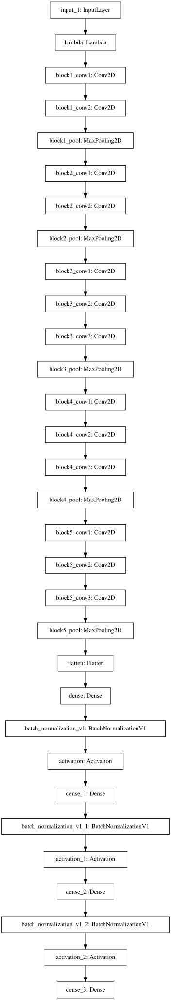

In [10]:
from IPython.display import SVG
from tensorflow.python.keras.utils.vis_utils import model_to_dot

SVG(model_to_dot(model).create(prog='dot', format='svg'))

# 学習

### train_target の内容　要検討

In [11]:
modelpath = '/root/userspace/final/models/new_data.h5'
callbacks = [
    EarlyStopping(monitor='val_loss', patience=50),
    ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=30),
    ModelCheckpoint(filepath=modelpath, monitor='val_total_acc', save_best_only=True)
]
batch_size=64
epochs = 5000
model.fit_generator(train_generator(x_tra, y_tra, batch_size),
                    steps_per_epoch=len(x_train)//batch_size,
                    epochs=epochs,
                    validation_data=val_generator(x_val, y_val, batch_size),
                    validation_steps=len(x_val)//batch_size,
                    callbacks=callbacks,
                    verbose=2)
# model.fit(x_train, y_train_ohe,
#           batch_size=128, epochs=1000, verbose=1, validation_split=0.1, callbacks=callbacks)

Instructions for updating:
Use tf.cast instead.
Epoch 1/5000
6/6 [==============================] - 4s 587ms/step - loss: 60.1551 - total_acc: 0.0000e+00 - binary_acc: 0.9782
 - 105s - loss: 31.4392 - total_acc: 7.6531e-04 - binary_acc: 0.9640 - val_loss: 60.1551 - val_total_acc: 0.0000e+00 - val_binary_acc: 0.9782
Epoch 2/5000
6/6 [==============================] - 3s 445ms/step - loss: 30.6268 - total_acc: 0.0030 - binary_acc: 0.9786
 - 63s - loss: 19.9115 - total_acc: 5.1020e-04 - binary_acc: 0.9813 - val_loss: 30.6268 - val_total_acc: 0.0030 - val_binary_acc: 0.9786
Epoch 3/5000
6/6 [==============================] - 3s 435ms/step - loss: 27.4859 - total_acc: 0.0000e+00 - binary_acc: 0.9776
 - 61s - loss: 19.5024 - total_acc: 7.6531e-04 - binary_acc: 0.9810 - val_loss: 27.4859 - val_total_acc: 0.0000e+00 - val_binary_acc: 0.9776
Epoch 4/5000
6/6 [==============================] - 3s 442ms/step - loss: 27.1299 - total_acc: 0.0000e+00 - binary_acc: 0.9805
 - 61s - loss: 18.9945 - tot

# 精度確認

In [12]:
model = load_model('/root/userspace/final/models/new_data.h5',
                   custom_objects={'binary_loss': binary_loss, 'total_acc': total_acc, 'binary_acc': binary_acc})

(?, ?)
(?, 262)


## test データ IoU 確認

In [48]:
# train
from PIL import Image
def predict(x, model):
    resize_x = np.zeros((x.shape[0], 224,224,3))
    for i, img in enumerate(x):
        print(img.shape)
        img = Image.fromarray(img).resize((224,224))
        resize_x[i] = np.asarray(img)

    print(resize_x.shape)
    preds = model.predict(resize_x)
    return preds

def calc_iou(x, y, model):
    preds = model.predict(x)
    #preds = predict(x, model)
    iou_list = []
    # [TODO] : 予測させる単語の確率
    th = 0.025
    for i, (pred, true_list) in tqdm(enumerate(zip(preds, x))):
        indexes = np.where(pred > th)[0]
        #print(indexes)
        pred_words = [detokenizer[idx+1] for idx in indexes]
        true_words = [detokenizer[idx] for idx in y[i] if idx != 0]
        # for idx in indexes:
        #     pred_words.append(tokenizer.index_word[idx+1])
        #     #true_words.append(test_tokenizer.index_word[])
        #print(f'---------------- img{i} ----------------')
        #print('pred words: ', pred_words)
        #print('true_words: ', true_words)
        
        num_i = len(set(pred_words) & set(true_words))
        num_u = len(set(pred_words) | set(true_words))
        iou_list.append(num_i / num_u)

        #plt.imshow(x[i]/255.)
        #plt.show()
    print('Total IoU: {}'.format(np.mean(iou_list)))
#calc_iou(x_train, y_train, model)

In [49]:
calc_iou(x_test, y_test, model)

580it [00:00, 16923.46it/s]

Total IoU: 0.10669643547036266


[ 7  1 65  0  0  0  0  0  0  0  0  0  0  0  0  0]
img 0: ['ねぎ', 'ゴマ', 'ゴマ油', 'ポン酢', '味噌', '黒胡椒']
true : ['オリーブオイル', '油揚げ', '醤油']
IoU: 0.0


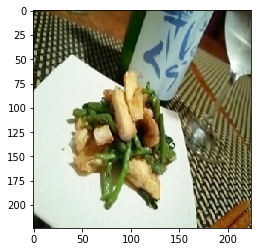

[113   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0]
img 1: ['こしょう', 'じゃがいも', 'ウインナー', 'オリーブオイル', 'コンソメ', 'ジェノベーゼソース', 'ニンニク', 'パセリ', 'ベーコン', 'レモン', '卵', '塩', '塩コショウ', '揚げ油', '片栗粉', '玉ねぎ', '粉チーズ', '鶏肉', '黒胡椒']
true : ['枝豆']
IoU: 0.0


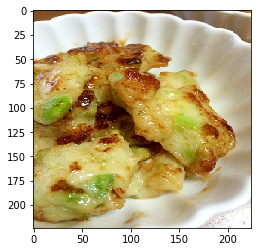

[221   6  11 177  64 220   0   0   0   0   0   0   0   0   0   0]
img 2: ['サラダ油', '卵', '塩コショウ', '炒め用油', '生姜', '醤油']
true : ['ご飯', 'ザーサイ', '卵', '塩コショウ', '炒め用油', '紅しょうが']
IoU: 0.3333333333333333


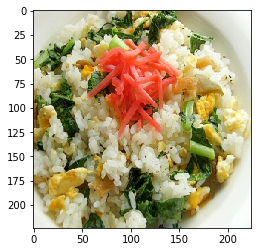

[61  7 12 19  0  0  0  0  0  0  0  0  0  0  0  0]
img 3: ['クレイジーソルト', 'ドレッシング', 'バター', 'パセリ', '塩', '玉ねぎ', '鶏肉']
true : ['オリーブオイル', 'チーズ', 'ナス', '黒胡椒']
IoU: 0.0


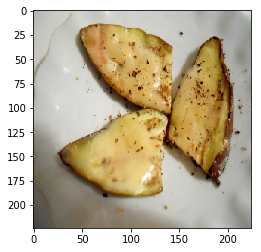

[ 6 46 57 59  5  0  0  0  0  0  0  0  0  0  0  0]
img 4: ['ゴマ油', 'ニンニク', 'ポン酢', '塩', '塩コショウ', '片栗粉', '納豆', '醤油', '鶏肉']
true : ['しめじ', 'オイスターソース', 'ゴマ油', '塩コショウ', '鶏ガラスープの素']
IoU: 0.16666666666666666


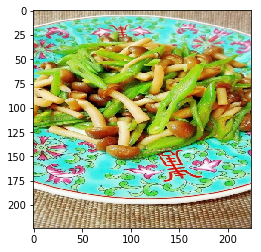

[  1  15   8  41  66 177 183   0   0   0   0   0   0   0   0   0]
img 5: ['こんにゃく', 'ねぎ', 'ポン酢', '塩', '小ねぎ', '砂糖', '醤油']
true : ['ねぎ', 'ピーマン', '一味唐辛子', '塩麹', '炒め用油', '片栗粉', '醤油']
IoU: 0.16666666666666666


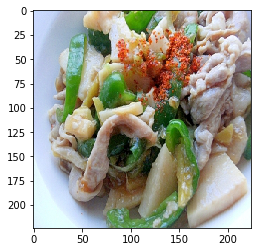

[105  25  48  41  13   0   0   0   0   0   0   0   0   0   0   0]
img 6: ['ねぎ', '塩', '大根', '大葉', '生姜', '粗目', '醤油', '鶏むね肉']
true : ['にんじん', 'キャノーラ油', 'キャベツ', 'ピーマン', '玉ねぎ']
IoU: 0.0


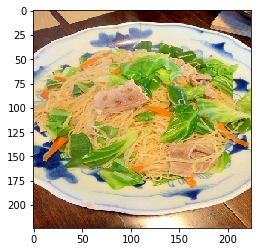

[129  41   0   0   0   0   0   0   0   0   0   0   0   0   0   0]
img 7: ['なんこつ', 'サラダ油', 'ピーマン', '酢']
true : ['なんこつ', 'ピーマン']
IoU: 0.5


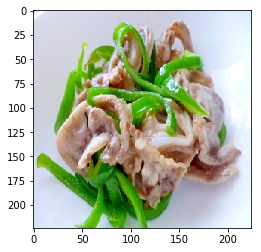

[ 16   3 143  17   8   1  82   9   0   0   0   0   0   0   0   0]
img 8: ['かぼちゃ', 'バター', '塩']
true : ['だしの素', 'だし醤油', 'ねぎ', 'みりん', 'サラダ油', '砂糖', '豆板醤', '醤油']
IoU: 0.0


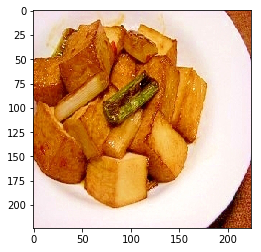

[ 56   6 107 108  11  14 128   0   0   0   0   0   0   0   0   0]
img 9: ['こしょう', 'わさび', 'アボカド', 'キュウリ', 'ニンニク', 'パセリ', 'マヨネーズ', '味噌', '塩', '麺つゆ']
true : ['ちくわ', 'パンケーキミックス', 'マヨネーズ', '卵', '塩コショウ', '大豆粉', '小松菜']
IoU: 0.0625


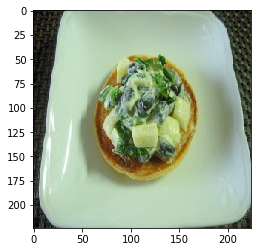

[ 13  52 107 108  11  82 112 113   0   0   0   0   0   0   0   0]
img 10: ['ねぎ', 'セロリ', 'ニンニク', '塩', '昆布', '醤油', '黒胡椒']
true : ['ケチャップ', 'ツナ', 'パンケーキミックス', '卵', '大豆粉', '枝豆', '玉ねぎ', '豆板醤']
IoU: 0.0


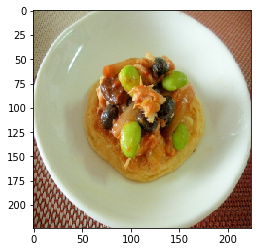

[ 28   1 107  10  11 108 215   0   0   0   0   0   0   0   0   0]
img 11: ['キュウリ', 'ズッキーニ', '味噌', '醤油']
true : ['カニカマ', 'キュウリ', 'パンケーキミックス', '卵', '大豆粉', '生姜', '醤油']
IoU: 0.2222222222222222


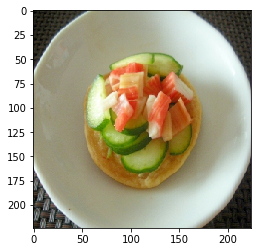

[ 28  56   1 107 108  11   0   0   0   0   0   0   0   0   0   0]
img 12: ['さつまいも', 'ちくわ', 'ズッキーニ', 'チーズ', '塩']
true : ['ちくわ', 'キュウリ', 'パンケーキミックス', '卵', '大豆粉', '醤油']
IoU: 0.1


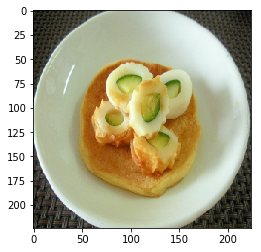

[256  81 107  80 108  11   0   0   0   0   0   0   0   0   0   0]
img 13: ['だしの素', 'はちみつ', 'オリーブ油', 'キムチ', 'マジックソルト', 'ヨーグルト', '塩', '納豆', '醤油']
true : ['さつまいも', 'ハム', 'パンケーキミックス', '卵', '大豆粉', '青海苔']
IoU: 0.0


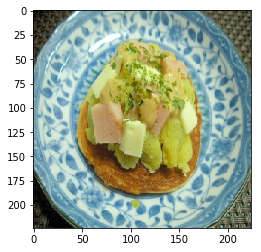

[ 25  56   1 107   5  79  11 108   0   0   0   0   0   0   0   0]
img 14: ['こんにゃく', 'ねぎ', 'ニンニク', 'マグロ', '味噌', '塩', '大根', '醤油']
true : ['ちくわ', 'にんじん', 'もやし', 'ゴマ油', 'パンケーキミックス', '卵', '大豆粉', '醤油']
IoU: 0.06666666666666667


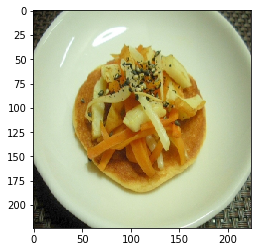

[  6  26 107 108  11  13  19   0   0   0   0   0   0   0   0   0]
img 15: ['バター', '卵', '塩']
true : ['こしょう', 'チーズ', 'パンケーキミックス', '卵', '塩コショウ', '大豆粉', '玉ねぎ']
IoU: 0.1111111111111111


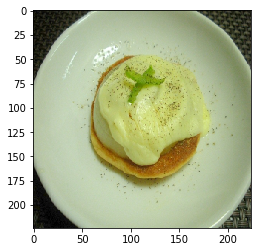

[16 32 80 11 96 14  0  0  0  0  0  0  0  0  0  0]
img 16: ['ねぎ', 'エビ', 'キャベツ', 'ゴマ油', 'マヨネーズ', '卵', '豆板醤', '豚肉', '鯵']
true : ['サラダ油', 'マヨネーズ', '卵', '長芋', '青海苔', '麺つゆ']
IoU: 0.15384615384615385


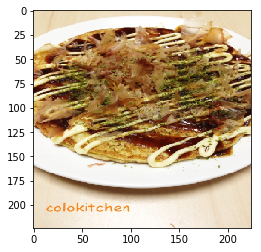

[108  11  54 107   0   0   0   0   0   0   0   0   0   0   0   0]
img 17: ['はんぺん', 'インスタントドライイースト', 'サラダ油', 'チーズ', 'バター', 'ブロッコリー', 'ベーコン', '塩', '牛乳', '砂糖']
true : ['パンケーキミックス', '卵', '大豆粉', '牛乳']
IoU: 0.07692307692307693


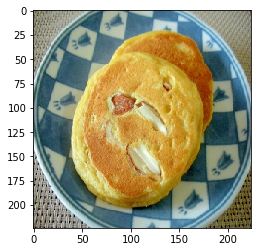

[ 56   8   1 107 108  11   0   0   0   0   0   0   0   0   0   0]
img 18: ['オリーブオイル', 'サラダ油', 'チーズ', 'ベーコン', '塩', '砂糖', '醤油']
true : ['ちくわ', 'ねぎ', 'パンケーキミックス', '卵', '大豆粉', '醤油']
IoU: 0.08333333333333333


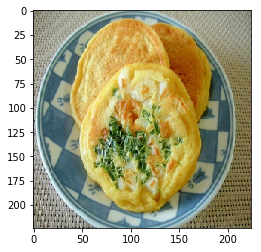

[108  11 107   0   0   0   0   0   0   0   0   0   0   0   0   0]
img 19: ['インスタントドライイースト', 'オリーブオイル', 'オリーブ油', 'チーズ', 'バター', 'マヨネーズ', '卵', '塩', '小麦粉', '片栗粉', '玉ねぎ', '醤油', '黒胡椒']
true : ['パンケーキミックス', '卵', '大豆粉']
IoU: 0.06666666666666667


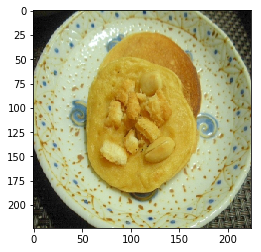

[ 40  37  17   1   9 191   0   0   0   0   0   0   0   0   0   0]
img 20: ['こしょう', 'オリーブ油', 'カレー粉', 'キュウリ', 'チーズ', 'レモン', '塩', '醤油', '黒胡椒']
true : ['えんどう豆', 'だしの素', 'みりん', '豆腐', '醤油', '鰹節']
IoU: 0.07142857142857142


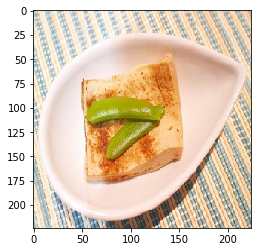

[  1 107 108  11 128   0   0   0   0   0   0   0   0   0   0   0]
img 21: ['じゃがいも', 'とろけるチーズ', 'みりん', 'オリーブオイル', 'ズッキーニ', 'チーズ', 'ニンニク', 'バター', 'ベーコン', 'マヨネーズ', '卵', '塩', '玉ねぎ', '砂糖', '黒胡椒']
true : ['パンケーキミックス', '卵', '大豆粉', '小松菜', '醤油']
IoU: 0.05263157894736842


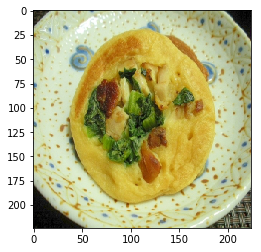

[107 198 108  11  64   0   0   0   0   0   0   0   0   0   0   0]
img 22: ['サラダ油', '卵', '塩', '砂糖', '醤油']
true : ['ご飯', 'パンケーキミックス', '卵', '塩糀', '大豆粉']
IoU: 0.1111111111111111


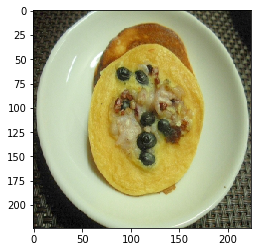

[ 42  18  48   6 107 108 106   7   0   0   0   0   0   0   0   0]
img 23: ['ねぎ', 'マヨネーズ', 'レタス', '卵', '塩', '玉ねぎ', '黒胡椒']
true : ['オリーブオイル', 'キャベツ', 'パセリ', 'パンケーキミックス', '塩コショウ', '大豆粉', '粒マスタード', '酢']
IoU: 0.0


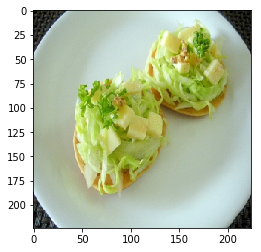

[ 46  41   1 107  10  11 108  77  13  53   0   0   0   0   0   0]
img 24: ['こしょう', 'ゴマ油', 'サラダ油', 'セロリ', 'ソース', 'レモン', '刺身', '塩', '玉ねぎ', '砂糖', '醤油']
true : ['しめじ', 'イカ', 'パンケーキミックス', 'ピーマン', 'レタス', '卵', '大豆粉', '玉ねぎ', '生姜', '醤油']
IoU: 0.10526315789473684


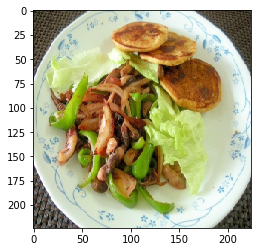

[125 242 107 108  13   0   0   0   0   0   0   0   0   0   0   0]
img 25: ['ねぎ', 'わさび', 'オリーブオイル', 'ソース', '大根', '大葉', '玉ねぎ', '醤油']
true : ['ドレッシング', 'パンケーキミックス', '大豆粉', '水菜', '玉ねぎ']
IoU: 0.08333333333333333


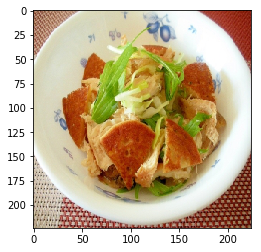

[ 25   6 107 108  14  19   0   0   0   0   0   0   0   0   0   0]
img 26: ['イカ', 'ゴマ油', 'ニンニク', 'バター', 'マヨネーズ', '塩', '塩コショウ', '大根', '玉ねぎ', '酢', '黒胡椒']
true : ['にんじん', 'チーズ', 'パンケーキミックス', 'マヨネーズ', '塩コショウ', '大豆粉']
IoU: 0.13333333333333333


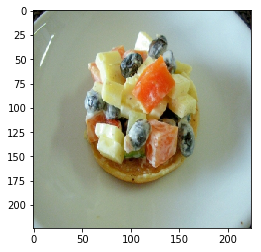

[ 61   3  47 245  80 177   9  60  23   0   0   0   0   0   0   0]
img 27: ['アスパラ', 'オリーブオイル', 'ズッキーニ', 'ベーコン', 'レモン', '塩', '塩コショウ', '玉ねぎ', '豚肉', '醤油', '黒胡椒']
true : ['こんにゃく', 'さつま揚げ', 'みりん', 'ナス', '刺身', '味噌', '炒め用油', '砂糖', '青海苔']
IoU: 0.0


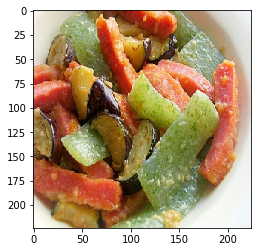

[108  11 107   0   0   0   0   0   0   0   0   0   0   0   0   0]
img 28: ['とろけるチーズ', 'チーズ', '塩']
true : ['パンケーキミックス', '卵', '大豆粉']
IoU: 0.0


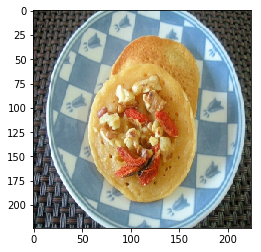

[16 56 23  8  0  0  0  0  0  0  0  0  0  0  0  0]
img 29: ['にんじん', 'トマト', 'ニンニク', 'ベーコン', 'マヨネーズ', 'レモン', '塩コショウ', '醤油', '鶏肉', '黒胡椒']
true : ['ちくわ', 'ねぎ', 'サラダ油', '味噌']
IoU: 0.0


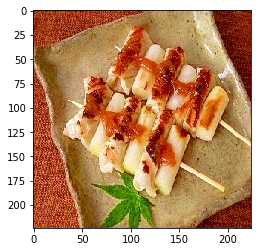

[ 33   6  15 140  34   0   0   0   0   0   0   0   0   0   0   0]
img 30: ['塩', '枝豆']
true : ['じゃがいも', '塩コショウ', '天ぷら粉', '揚げ油', '片栗粉']
IoU: 0.0


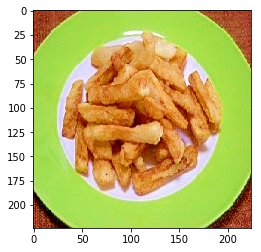

[  1 107 108  11  76 215   0   0   0   0   0   0   0   0   0   0]
img 31: ['こしょう', 'サラダ油', 'バター', 'レンコン', '卵', '塩', '片栗粉', '麩']
true : ['カニカマ', 'パンケーキミックス', 'レンコン', '卵', '大豆粉', '醤油']
IoU: 0.16666666666666666


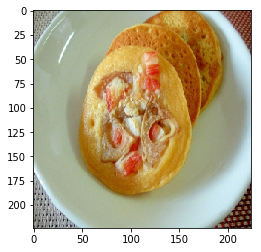

[108  11 107   0   0   0   0   0   0   0   0   0   0   0   0   0]
img 32: ['こしょう', 'とろけるチーズ', 'オリーブオイル', 'ソース', '塩', '玉ねぎ', '砂糖', '黒胡椒']
true : ['パンケーキミックス', '卵', '大豆粉']
IoU: 0.0


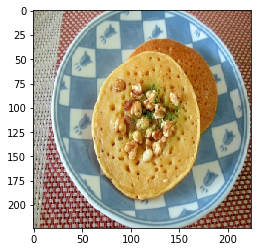

[ 78  56   1 107 108  11   0   0   0   0   0   0   0   0   0   0]
img 33: ['こしょう', 'とろけるチーズ', 'オリーブオイル', 'オリーブ油', 'ケチャップ', 'チーズ', 'バター', 'ベーコン', 'マヨネーズ', 'レモン', '刺身', '塩コショウ', '玉ねぎ', '生ハム', '黒胡椒']
true : ['ちくわ', 'パンケーキミックス', 'ブロッコリー', '卵', '大豆粉', '醤油']
IoU: 0.0


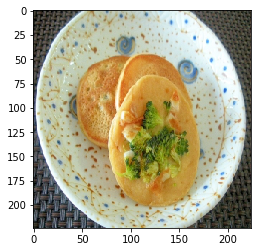

[ 54   1 107 108  11 128   0   0   0   0   0   0   0   0   0   0]
img 34: ['こしょう', 'みりん', 'わさび', '味噌', '砂糖', '醤油', '鷹の爪']
true : ['パンケーキミックス', '卵', '大豆粉', '小松菜', '牛乳', '醤油']
IoU: 0.08333333333333333


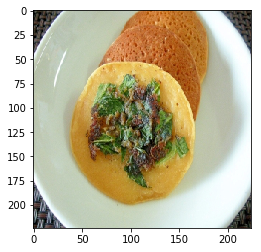

[  3 212   8   1  66   0   0   0   0   0   0   0   0   0   0   0]
img 35: ['ほうれん草', 'エビ', 'オリーブオイル', 'ニンニク', 'バター', '塩', '塩コショウ', '牛乳', '玉ねぎ', '生クリーム', '白子', '砂糖', '鱈', '鶏肉']
true : ['かまぼこ', 'ねぎ', '一味唐辛子', '砂糖', '醤油']
IoU: 0.05555555555555555


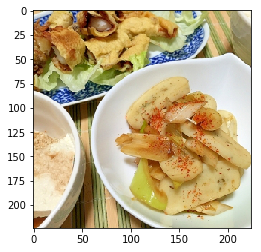

[107 239 108 112  11 106   0   0   0   0   0   0   0   0   0   0]
img 36: ['こしょう', 'オリーブオイル', 'コンソメ', 'ニンニク', '塩', '塩コショウ', '玉ねぎ']
true : ['ゴーヤ', 'ツナ', 'パンケーキミックス', '卵', '大豆粉', '粒マスタード']
IoU: 0.0


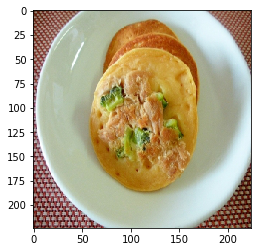

[108  11  30 107   0   0   0   0   0   0   0   0   0   0   0   0]
img 37: ['たらこ', 'みりん', 'ゴマ油', 'チーズ', 'バター', '砂糖', '醤油', '麺つゆ']
true : ['ゴマ', 'パンケーキミックス', '卵', '大豆粉']
IoU: 0.0


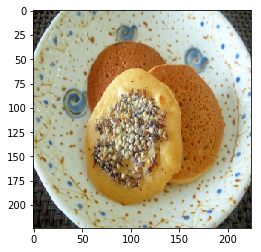

[ 54   6  81 107 108  11   0   0   0   0   0   0   0   0   0   0]
img 38: ['オリーブオイル', '塩', '酢', '醤油', '黒胡椒']
true : ['ハム', 'パンケーキミックス', '卵', '塩コショウ', '大豆粉', '牛乳']
IoU: 0.0


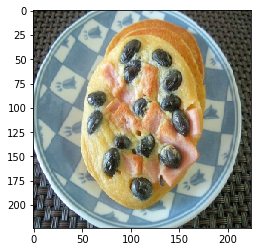

[ 42  54  52   6 148 107 108  11   0   0   0   0   0   0   0   0]
img 39: ['こしょう', 'セロリ', 'チーズ', 'トマト', '塩', '麺つゆ']
true : ['ケチャップ', 'ソーセージ', 'パセリ', 'パンケーキミックス', '卵', '塩コショウ', '大豆粉', '牛乳']
IoU: 0.0


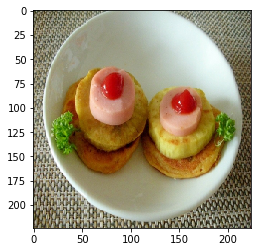

[139 136   0   0   0   0   0   0   0   0   0   0   0   0   0   0]
img 40: ['わさび', 'オリーブオイル', 'カニ', 'サラダ油', 'バター', 'マヨネーズ', '塩コショウ', '大根', '小麦粉', '醤油', '鰆']
true : ['はんぺん', '味の素']
IoU: 0.0


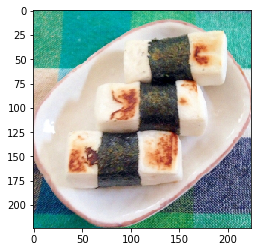

[105  25  48   6   1  41  13   0   0   0   0   0   0   0   0   0]
img 41: ['ねぎ', 'みりん', 'シイタケ', '砂糖', '醤油']
true : ['にんじん', 'キャノーラ油', 'キャベツ', 'ピーマン', '塩コショウ', '玉ねぎ', '醤油']
IoU: 0.09090909090909091


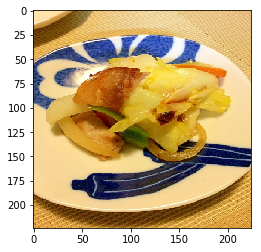

[  3 143  56  46  14   0   0   0   0   0   0   0   0   0   0   0]
img 42: ['だしの素', 'みりん', 'サラダ油', '生姜', '砂糖', '醤油']
true : ['しめじ', 'だし醤油', 'ちくわ', 'マヨネーズ', '砂糖']
IoU: 0.1


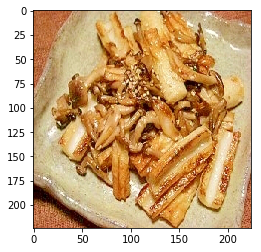

[ 3 25 17  1  5  9 76  0  0  0  0  0  0  0  0  0]
img 43: ['ねぎ', 'ゴマ油', 'ラー油', '塩', '醤油', '黒胡椒']
true : ['だしの素', 'にんじん', 'みりん', 'ゴマ油', 'レンコン', '砂糖', '醤油']
IoU: 0.18181818181818182


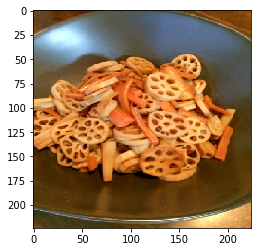

[156  24   2  12  10   4   7   0   0   0   0   0   0   0   0   0]
img 44: ['オリーブオイル', 'トマト', '唐揚げ粉', '塩', '揚げ油', '鶏肉']
true : ['オリーブオイル', 'カレー粉', 'ニンニク', '塩', '生姜', '鶏肉', '黒胡椒']
IoU: 0.3


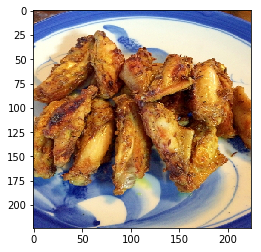

[105   6 239  71  11   0   0   0   0   0   0   0   0   0   0   0]
img 45: ['ニンニク', '塩', '大葉', '黒胡椒']
true : ['キャノーラ油', 'ゴーヤ', '卵', '厚揚げ', '塩コショウ']
IoU: 0.0


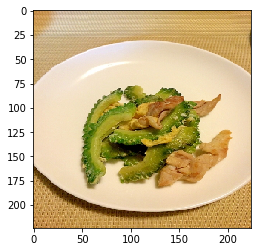

[ 3 25 18 17 15 41 24  1 13  0  0  0  0  0  0  0]
img 46: ['こんにゃく', 'ねぎ', 'みりん', '塩', '大根', '生姜', '砂糖', '酢', '醤油']
true : ['だしの素', 'にんじん', 'ピーマン', '片栗粉', '玉ねぎ', '砂糖', '酢', '醤油', '鶏肉']
IoU: 0.2


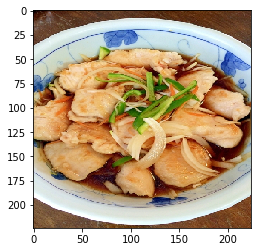

[ 1 71 41 10  0  0  0  0  0  0  0  0  0  0  0  0]
img 47: ['ねぎ', 'みりん', 'アスパラガス', 'アラ', 'ゴマ油', '厚揚げ', '塩コショウ', '大根', '辛子', '醤油', '鰯']
true : ['ピーマン', '厚揚げ', '生姜', '醤油']
IoU: 0.15384615384615385


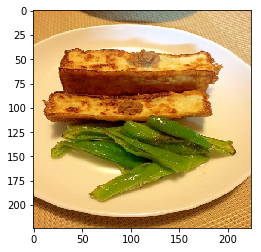

[108  11  14 107   0   0   0   0   0   0   0   0   0   0   0   0]
img 48: ['こしょう', 'サラダ油', 'ニンニク', '塩', '醤油', '麺つゆ']
true : ['パンケーキミックス', 'マヨネーズ', '卵', '大豆粉']
IoU: 0.0


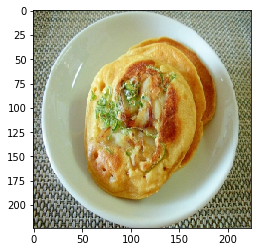

[125 188  15   1 107 108  11   0   0   0   0   0   0   0   0   0]
img 49: ['だしの素', 'ゴマ', 'チーズ', 'ブロッコリー', 'マヨネーズ', '味噌', '塩', '大根', '醤油']
true : ['パンケーキミックス', '卵', '大豆粉', '水菜', '片栗粉', '秋刀魚', '醤油']
IoU: 0.06666666666666667


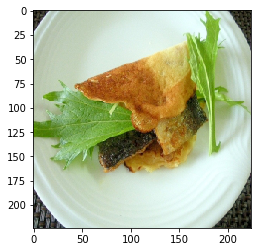

[120 107 108  11  62 128   0   0   0   0   0   0   0   0   0   0]
img 50: ['こしょう', 'セロリ', 'チーズ', 'トマト', 'ニンニク', 'バター', 'レタス', '塩', '牛乳', '醤油', '黒胡椒']
true : ['ウインナー', 'パンケーキミックス', '卵', '大豆粉', '小松菜', '粉チーズ']
IoU: 0.0


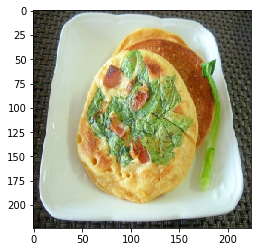

[108  11  19 107   0   0   0   0   0   0   0   0   0   0   0   0]
img 51: ['オリーブオイル', 'バター', 'ベーコン', 'マグロ', 'レモン', '塩', '大根', '粉チーズ', '黒胡椒']
true : ['チーズ', 'パンケーキミックス', '卵', '大豆粉']
IoU: 0.0


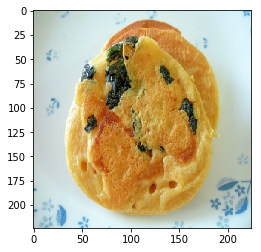

[ 58  56  80 107 108  11 162   0   0   0   0   0   0   0   0   0]
img 52: ['こしょう', 'みりん', 'サラダ油', 'ニンニク', '塩', '塩コショウ', '砂糖', '醤油']
true : ['ちくわ', 'ウスターソース', 'パンケーキミックス', '卵', '大豆粉', '白ごま', '青海苔']
IoU: 0.0


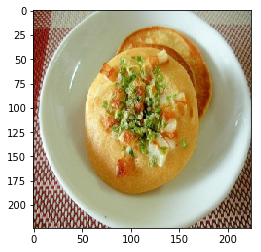

[ 46  41 107 198 108  11   0   0   0   0   0   0   0   0   0   0]
img 53: ['とろけるチーズ', 'コーン', '塩', '赤ワイン']
true : ['しめじ', 'パンケーキミックス', 'ピーマン', '卵', '塩糀', '大豆粉']
IoU: 0.0


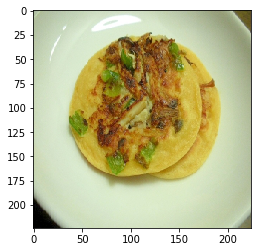

[ 40  54   1 107  80 108  11  64   0   0   0   0   0   0   0   0]
img 54: ['こしょう', 'ケチャップ', 'サラダ油', 'ソーセージ', 'ニンニク', 'パン粉', 'ベーコン', '塩', '玉ねぎ', '砂糖']
true : ['ご飯', 'パンケーキミックス', '卵', '大豆粉', '牛乳', '醤油', '青海苔', '鰹節']
IoU: 0.0


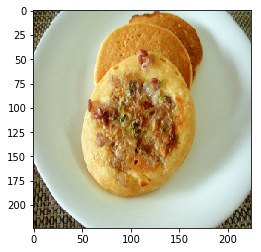

[ 54 259  22 107   2  12 108   0   0   0   0   0   0   0   0   0]
img 55: ['ご飯', 'だしの素', 'みりん', 'バター', '塩', '湯葉', '醤油']
true : ['いくら', 'パンケーキミックス', 'レモン', '塩', '大豆粉', '牛乳', '黒胡椒']
IoU: 0.07692307692307693


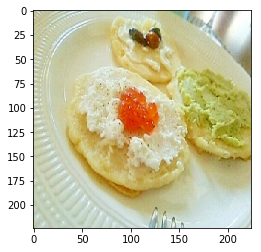

[ 25   6   8  24 107 108  11   0   0   0   0   0   0   0   0   0]
img 56: ['とろけるチーズ', 'はちみつ', 'バター', '卵', '塩', '砂糖', '酢', '醤油', '鷹の爪']
true : ['にんじん', 'ねぎ', 'パンケーキミックス', '卵', '塩コショウ', '大豆粉', '鶏肉']
IoU: 0.06666666666666667


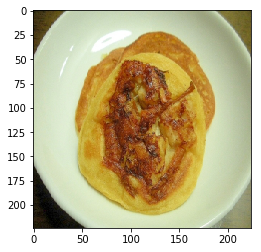

[ 27 119 107 108  11  14   0   0   0   0   0   0   0   0   0   0]
img 57: ['みりん', 'キュウリ', 'チーズ', 'バター', 'マヨネーズ', 'レタス', '味噌', '大根', '醤油']
true : ['パンケーキミックス', 'マヨネーズ', '卵', '大根', '大豆粉', '梅干し']
IoU: 0.15384615384615385


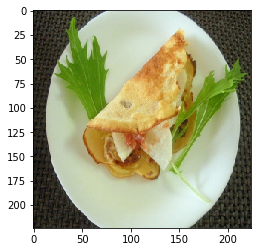

[ 42  54  81 107 108  11   0   0   0   0   0   0   0   0   0   0]
img 58: ['コーン', 'サラダ油', 'ベーコン', '卵', '塩', '砂糖']
true : ['ハム', 'パセリ', 'パンケーキミックス', '卵', '大豆粉', '牛乳']
IoU: 0.09090909090909091


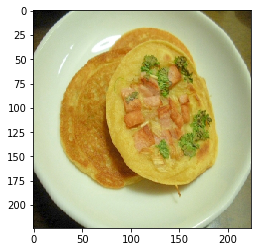

[125   6   8 107 108  11  14   0   0   0   0   0   0   0   0   0]
img 59: ['アボカド', 'エビ', 'オリーブオイル', 'コンソメ', 'チーズ', 'ニンニク', 'バター', 'マッシュルーム', 'マヨネーズ', '卵', '塩', '小麦粉', '牛乳', '玉ねぎ', '生クリーム', '白ワイン', '醤油', '黒胡椒']
true : ['ねぎ', 'パンケーキミックス', 'マヨネーズ', '卵', '塩コショウ', '大豆粉', '水菜']
IoU: 0.08695652173913043


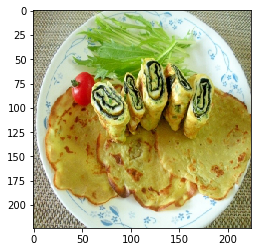

[ 25   6   8  24 107 108  11   0   0   0   0   0   0   0   0   0]
img 60: ['とろけるチーズ', 'はちみつ', 'バター', '卵', '塩', '砂糖', '酢', '醤油', '鷹の爪']
true : ['にんじん', 'ねぎ', 'パンケーキミックス', '卵', '塩コショウ', '大豆粉', '鶏肉']
IoU: 0.06666666666666667


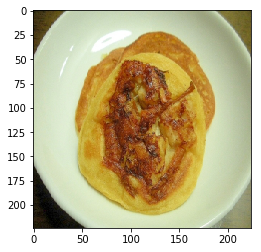

[ 27 119 107 108  11  14   0   0   0   0   0   0   0   0   0   0]
img 61: ['みりん', 'キュウリ', 'チーズ', 'バター', 'マヨネーズ', 'レタス', '味噌', '大根', '醤油']
true : ['パンケーキミックス', 'マヨネーズ', '卵', '大根', '大豆粉', '梅干し']
IoU: 0.15384615384615385


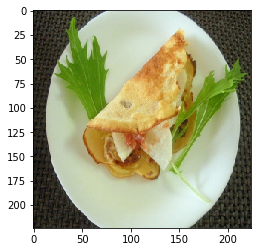

[ 42  54  81 107 108  11   0   0   0   0   0   0   0   0   0   0]
img 62: ['コーン', 'サラダ油', 'ベーコン', '卵', '塩', '砂糖']
true : ['ハム', 'パセリ', 'パンケーキミックス', '卵', '大豆粉', '牛乳']
IoU: 0.09090909090909091


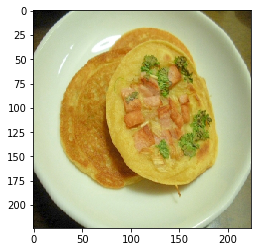

[125   6   8 107 108  11  14   0   0   0   0   0   0   0   0   0]
img 63: ['アボカド', 'エビ', 'オリーブオイル', 'コンソメ', 'チーズ', 'ニンニク', 'バター', 'マッシュルーム', 'マヨネーズ', '卵', '塩', '小麦粉', '牛乳', '玉ねぎ', '生クリーム', '白ワイン', '醤油', '黒胡椒']
true : ['ねぎ', 'パンケーキミックス', 'マヨネーズ', '卵', '塩コショウ', '大豆粉', '水菜']
IoU: 0.08695652173913043


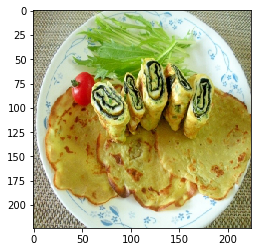

[108  11  54 107   0   0   0   0   0   0   0   0   0   0   0   0]
img 64: ['こしょう', 'たらこ', 'オリーブオイル', '卵', '塩', '玉ねぎ', '砂糖', '赤ワイン']
true : ['パンケーキミックス', '卵', '大豆粉', '牛乳']
IoU: 0.09090909090909091


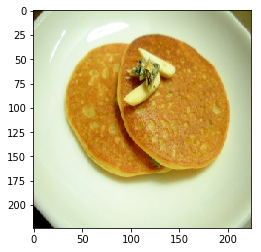

[125 107 108  11  14   0   0   0   0   0   0   0   0   0   0   0]
img 65: ['にんじん', 'アスパラ', 'コンソメ', 'チーズ', 'トマト', 'マヨネーズ', 'ヨーグルト', 'レタス', '味噌', '春巻きの皮', '生ハム']
true : ['パンケーキミックス', 'マヨネーズ', '卵', '大豆粉', '水菜']
IoU: 0.06666666666666667


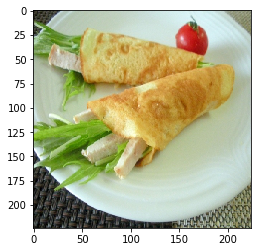

[ 27  32  11 202  29   0   0   0   0   0   0   0   0   0   0   0]
img 66: ['じゃがいも', 'だしの素', 'ねぎ', 'みりん', 'ゴマ油', 'サラダ油', '塩', '塩コショウ', '大根', '小麦粉', '片栗粉']
true : ['卵', '大根', '小麦粉', '山芋', '麺つゆ']
IoU: 0.14285714285714285


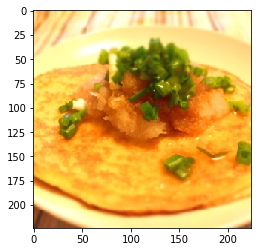

[ 54 107 198 108  11   0   0   0   0   0   0   0   0   0   0   0]
img 67: ['とろけるチーズ', 'オリーブオイル', 'オリーブ油', 'ケチャップ', 'チーズ', 'トマト', 'ニンニク', '塩コショウ', '月桂樹', '玉ねぎ', '砂糖', '醤油']
true : ['パンケーキミックス', '卵', '塩糀', '大豆粉', '牛乳']
IoU: 0.0


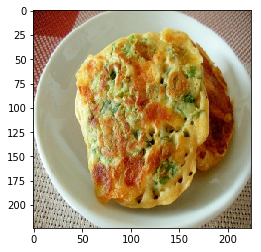

[42  6 46  4  7 53  0  0  0  0  0  0  0  0  0  0]
img 68: ['ねぎ', 'イカ', 'オリーブオイル', 'ゴマ油', 'マヨネーズ', '塩コショウ', '酢', '醤油', '鶏肉']
true : ['しめじ', 'イカ', 'オリーブオイル', 'ニンニク', 'パセリ', '塩コショウ']
IoU: 0.25


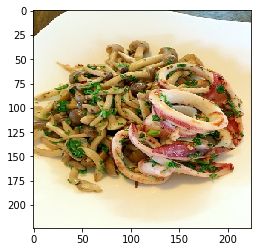

[33 15  2 13  0  0  0  0  0  0  0  0  0  0  0  0]
img 69: ['じゃがいも', 'エビ', '醤油']
true : ['じゃがいも', '塩', '片栗粉', '玉ねぎ']
IoU: 0.16666666666666666


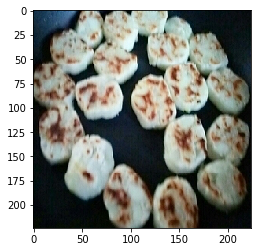

[108  11 107   0   0   0   0   0   0   0   0   0   0   0   0   0]
img 70: ['ちくわ', 'サラダ油', 'ズッキーニ', 'チーズ', 'バター', '塩']
true : ['パンケーキミックス', '卵', '大豆粉']
IoU: 0.0


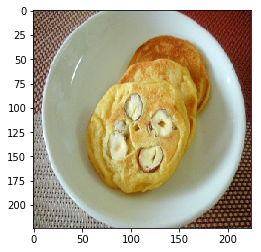

[16 65 48  6 36  0  0  0  0  0  0  0  0  0  0  0]
img 71: ['こしょう', 'じゃがいも', 'マヨネーズ', '卵', '塩', '塩コショウ', '小麦粉', '揚げ油', '油揚げ', '片栗粉', '豚肉', '餃子の皮', '鶏肉']
true : ['とろけるチーズ', 'キャベツ', 'サラダ油', '塩コショウ', '油揚げ']
IoU: 0.125


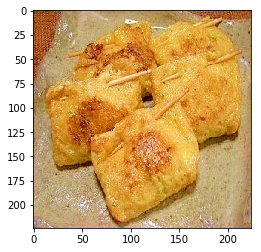

[  5  32 206   0   0   0   0   0   0   0   0   0   0   0   0   0]
img 72: ['こしょう', 'ちくわ', 'はちみつ', '塩', '大根', '日本酒', '醤油', '長芋']
true : ['たけのこ', 'ゴマ油', '麺つゆ']
IoU: 0.0


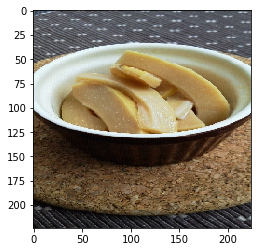

[4 7 1 0 0 0 0 0 0 0 0 0 0 0 0 0]
img 73: ['ねぎ', 'ガーリックソルト', 'ゴマ油', 'シイタケ', 'ポン酢', '味噌']
true : ['オリーブオイル', 'ニンニク', '醤油']
IoU: 0.0


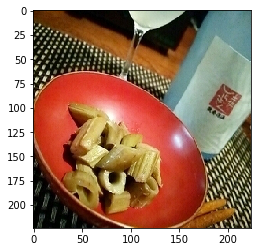

[  7 186  11   6   0   0   0   0   0   0   0   0   0   0   0   0]
img 74: ['かぼちゃ', 'こしょう', 'みりん', 'トマト', 'レモン', '卵', '塩', '塩コショウ', '砂糖', '粉チーズ', '豚肉']
true : ['オリーブオイル', '卵', '塩コショウ', '舞茸']
IoU: 0.15384615384615385


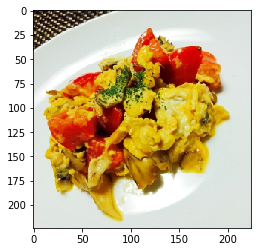

[16 45 43  0  0  0  0  0  0  0  0  0  0  0  0  0]
img 75: ['だしの素', 'みりん', 'オイスターソース', 'ゴマ', 'マヨネーズ', '塩', '天ぷら粉', '日本酒', '玉ねぎ', '生姜', '砂糖', '豚肉', '醤油', '鶏肉']
true : ['オリーブ油', 'サラダ油', 'ベーコン']
IoU: 0.0


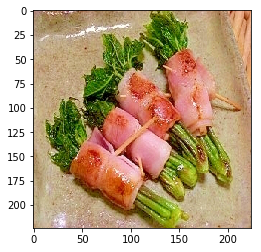

[54  6 41 20 11 13  7  0  0  0  0  0  0  0  0  0]
img 76: ['みりん', 'オリーブオイル', 'マヨネーズ', '卵', '塩', '砂糖', '醤油', '黒胡椒']
true : ['オリーブオイル', 'バター', 'ピーマン', '卵', '塩コショウ', '牛乳', '玉ねぎ']
IoU: 0.15384615384615385


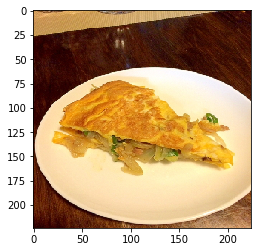

[ 42  33  46   6 157   7   0   0   0   0   0   0   0   0   0   0]
img 77: ['ねぎ', 'アスパラガス', 'ガーリックソルト', 'ゴマ油', 'バター', 'ポン酢', '塩', '鴨', '黒胡椒']
true : ['しめじ', 'じゃがいも', 'オリーブオイル', 'パセリ', 'ローズマリー', '塩コショウ']
IoU: 0.0


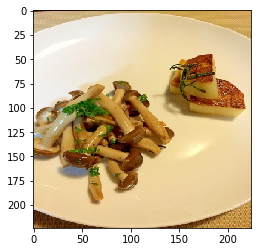

[20 69 11  7 21  0  0  0  0  0  0  0  0  0  0  0]
img 78: ['バター', 'マーガリン', '卵', '塩']
true : ['はちみつ', 'オリーブオイル', 'バター', '卵', '日本酒']
IoU: 0.2857142857142857


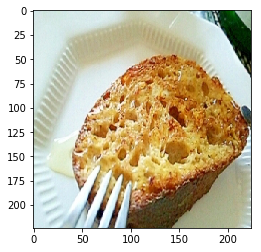

[  2  12  45  36   7 191   0   0   0   0   0   0   0   0   0   0]
img 79: ['オリーブオイル', 'バルサミコ酢', '塩', '醤油']
true : ['えんどう豆', 'とろけるチーズ', 'オリーブオイル', 'ベーコン', '塩', '黒胡椒']
IoU: 0.25


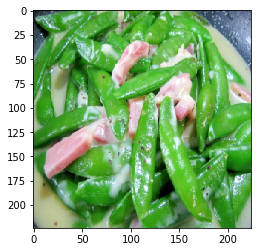

[ 63   1   5  13 111   0   0   0   0   0   0   0   0   0   0   0]
img 80: ['オリーブオイル', 'ニンニク', '味噌', '塩', '塩コショウ', '醤油']
true : ['キムチ', 'ゴマ油', 'シイタケ', '玉ねぎ', '醤油']
IoU: 0.1


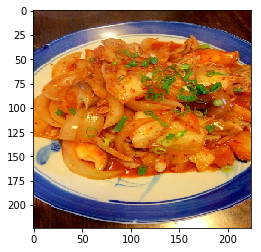

[ 37  17   8  80 109  34   0   0   0   0   0   0   0   0   0   0]
img 81: ['だしの素', 'ねぎ', 'オイスターソース', 'ゴマ油', 'サラダ油', 'ポン酢', '塩', '大根', '小麦粉', '片栗粉', '生姜', '豆腐', '豚肉', '醤油']
true : ['だしの素', 'ねぎ', '揚げ油', '薄力粉', '豆腐', '青海苔']
IoU: 0.17647058823529413


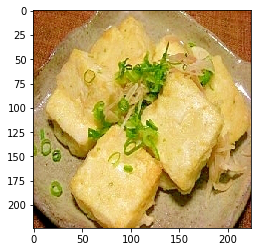

[63  6 79 36 13  0  0  0  0  0  0  0  0  0  0  0]
img 82: ['にんじん', 'みりん', 'ゴマ油', 'ニンニク', '塩', '玉ねぎ', '酢', '青じそ', '麺つゆ']
true : ['とろけるチーズ', 'もやし', 'シイタケ', '塩コショウ', '玉ねぎ']
IoU: 0.07692307692307693


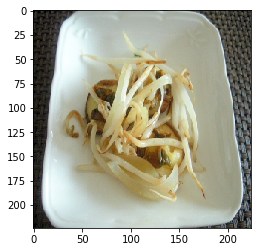

[ 49   2 206   4   7   0   0   0   0   0   0   0   0   0   0   0]
img 83: ['ちくわ', 'にんじん', 'チーズ', '味噌', '塩', '大根', '日本酒', '柿', '砂糖', '辛子']
true : ['たけのこ', 'オリーブオイル', 'ニンニク', '塩', '鷹の爪']
IoU: 0.07142857142857142


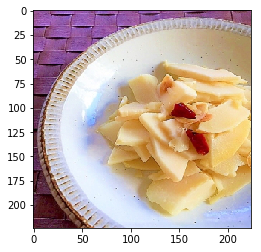

[61  1  8  2 82 14  0  0  0  0  0  0  0  0  0  0]
img 84: ['にんじん', 'レモン', '塩', '日本酒', '河豚']
true : ['ねぎ', 'ナス', 'マヨネーズ', '塩', '豆板醤', '醤油']
IoU: 0.1


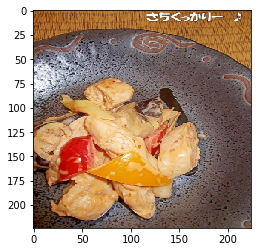

[  6   1 110   5  30   0   0   0   0   0   0   0   0   0   0   0]
img 85: ['にんじん', 'ほうれん草', 'みりん', 'もやし', 'カニカマ', 'ゴマ', 'ゴマ油', 'ニンニク', '塩', '塩コショウ', '大根', '玉ねぎ', '酢', '鷹の爪', '麺つゆ']
true : ['エリンギ', 'ゴマ', 'ゴマ油', '塩コショウ', '醤油']
IoU: 0.17647058823529413


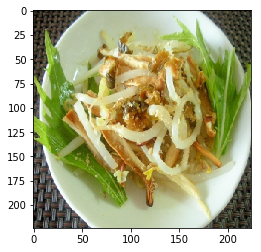

[ 1 20  2 12  9  7 99  0  0  0  0  0  0  0  0  0]
img 86: ['みりん', 'わさび', '塩', '日本酒', '昆布', '片栗粉', '生姜', '白子', '酢', '醤油']
true : ['みりん', 'オリーブオイル', 'バター', 'ホタテ', '塩', '醤油', '黒胡椒']
IoU: 0.21428571428571427


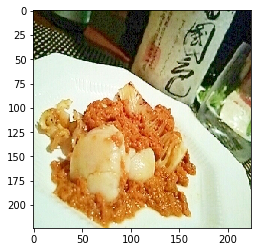

[ 16  40   8  71  11  14 220   0   0   0   0   0   0   0   0   0]
img 87: ['こしょう', 'にんじん', 'ねぎ', 'キュウリ', 'ゴマ油', 'ポン酢', '七味唐辛子', '味噌', '大葉', '片栗粉', '玉ねぎ', '醤油']
true : ['ねぎ', 'サラダ油', 'マヨネーズ', '卵', '厚揚げ', '紅しょうが', '鰹節']
IoU: 0.05555555555555555


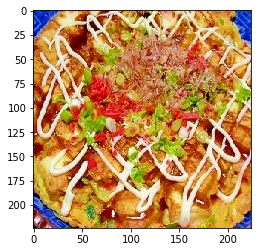

[40  8 31 65  0  0  0  0  0  0  0  0  0  0  0  0]
img 88: ['ねぎ', 'カイワレ', 'ゴマ', 'ゴマ油', 'ポン酢', '味の素', '片栗粉', '砂糖', '豆板醤', '豆腐', '酢', '醤油', '鰹節']
true : ['ねぎ', 'ポン酢', '油揚げ', '鰹節']
IoU: 0.21428571428571427


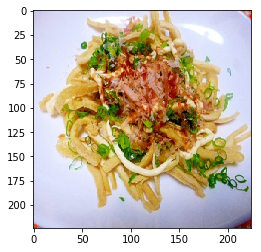

[32 46 26  8 11  0  0  0  0  0  0  0  0  0  0  0]
img 89: ['とろけるチーズ', 'エビ', 'オリーブオイル', 'チーズ', 'ニンニク', 'バター', 'パセリ', 'ブロッコリー', 'ベーコン', '塩', '黒胡椒']
true : ['こしょう', 'しめじ', 'ねぎ', '卵', '麺つゆ']
IoU: 0.0


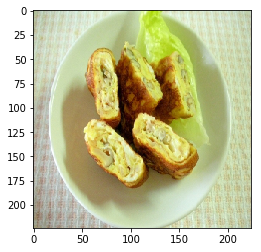

[ 16  33 124 104   0   0   0   0   0   0   0   0   0   0   0   0]
img 90: ['じゃがいも', 'オリーブオイル', 'バター', 'パセリ', 'ベーコン', '塩', '黒胡椒']
true : ['じゃがいも', 'サラダ油', 'バジル', 'マジックソルト']
IoU: 0.1


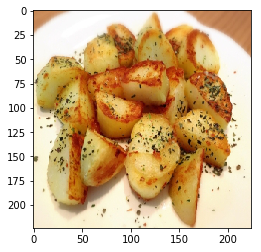

[ 7  2 14 13  0  0  0  0  0  0  0  0  0  0  0  0]
img 91: ['だしの素', 'にんじん', 'ねぎ', 'みりん', 'タコ', 'マグロ', '三温糖', '味噌', '塩', '大根', '玉ねぎ', '醤油']
true : ['オリーブオイル', 'マヨネーズ', '塩', '玉ねぎ']
IoU: 0.14285714285714285


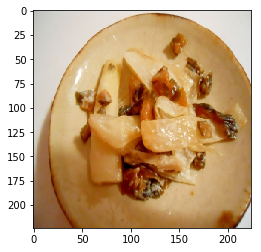

[10  8 83  0  0  0  0  0  0  0  0  0  0  0  0  0]
img 92: ['こしょう', 'ねぎ', 'わさび', 'キュウリ', 'ゴマ油', 'ニンニク', 'レモン', '塩', '塩コショウ', '生姜', '豆板醤', '醤油']
true : ['ねぎ', '唐辛子', '生姜']
IoU: 0.15384615384615385


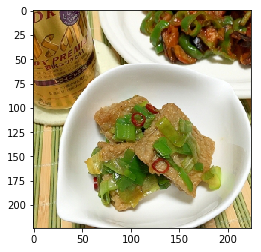

[ 27  63   3  31   1  11 177   0   0   0   0   0   0   0   0   0]
img 93: ['パン粉', '卵', '塩', '小麦粉', '揚げ油', '片栗粉', '粉チーズ']
true : ['シイタケ', 'ポン酢', '卵', '大根', '炒め用油', '砂糖', '醤油']
IoU: 0.07692307692307693


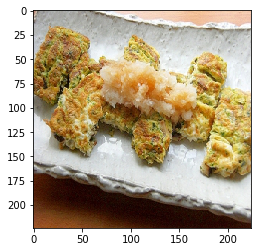

[48 12  2  0  0  0  0  0  0  0  0  0  0  0  0  0]
img 94: ['ご飯', 'キャベツ', 'キュウリ', 'ゴマ油', 'バター', '塩', '大根', '日本酒', '酢', '醤油', '黒胡椒']
true : ['キャベツ', '塩', '黒胡椒']
IoU: 0.2727272727272727


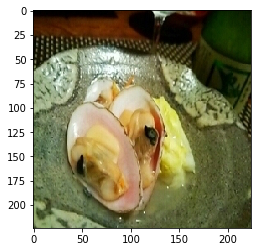

[235  11   8   2   0   0   0   0   0   0   0   0   0   0   0   0]
img 95: ['だしの素', 'オリーブオイル', 'バター', 'マヨネーズ', 'レモン', '卵', '味噌', '塩', '昆布', '醤油', '黒胡椒']
true : ['ねぎ', 'ホヤ', '卵', '塩']
IoU: 0.15384615384615385


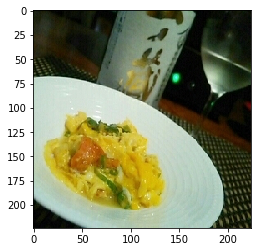

[105  39   6  41   1  71  10   0   0   0   0   0   0   0   0   0]
img 96: ['ごぼう', 'みりん', 'オリーブ油', '塩', '塩コショウ', '白ごま', '醤油']
true : ['キャノーラ油', 'ピーマン', '厚揚げ', '塩コショウ', '生姜', '豚肉', '醤油']
IoU: 0.16666666666666666


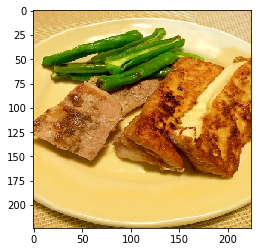

[ 75  49   2 130  12   7   0   0   0   0   0   0   0   0   0   0]
img 97: ['こしょう', 'アラ', 'セロリ', 'ライム', 'レモン', '塩', '山椒', '日本酒', '菜種油', '酢', '醤油', '鰯']
true : ['オリーブオイル', '塩', '月桂樹', '牡蠣', '鷹の爪', '黒胡椒']
IoU: 0.058823529411764705


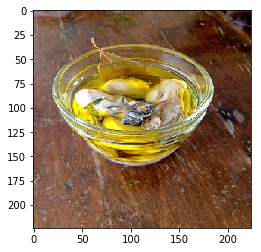

[42 33 29  2  0  0  0  0  0  0  0  0  0  0  0  0]
img 98: ['えんどう豆', 'こしょう', 'サラダ油', 'ライム', 'レモン', '卵', '塩', '塩コショウ', '小麦粉', '豚肉', '醤油']
true : ['じゃがいも', 'パセリ', '塩', '小麦粉']
IoU: 0.15384615384615385


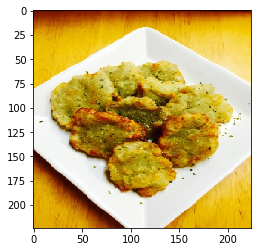

[ 7  1 19  0  0  0  0  0  0  0  0  0  0  0  0  0]
img 99: ['こしょう', 'みりん', 'わさび', 'マヨネーズ', '卵', '塩', '塩コショウ', '玉ねぎ', '砂糖', '酒粕', '醤油']
true : ['オリーブオイル', 'チーズ', '醤油']
IoU: 0.07692307692307693


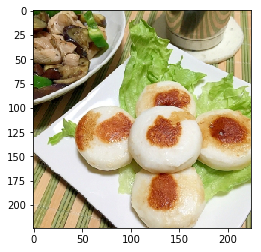

[  1 206  20   0   0   0   0   0   0   0   0   0   0   0   0   0]
img 100: ['にんじん', 'はちみつ', 'みりん', '塩', '大根', '牛肉', '玉ねぎ', '赤ワイン', '醤油']
true : ['たけのこ', 'バター', '醤油']
IoU: 0.09090909090909091


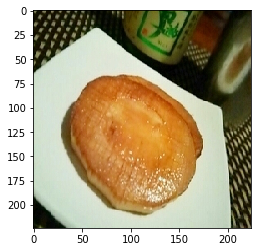

[ 61   7 122   8   0   0   0   0   0   0   0   0   0   0   0   0]
img 101: ['こしょう', 'イカ', 'サラダ油', 'チーズ', 'ニンニク', 'ローズマリー', '味噌', '塩', '塩コショウ', '大根', '枝豆', '玉ねぎ']
true : ['ねぎ', 'オリーブオイル', 'コチュジャン', 'ナス']
IoU: 0.0


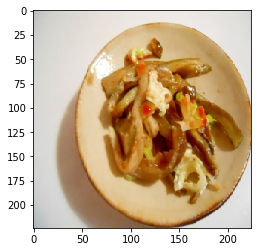

[ 16 120  26  13  19   0   0   0   0   0   0   0   0   0   0   0]
img 102: ['こしょう', 'ウインナー', 'ゴマ油', 'サラダ油', 'チーズ', '玉ねぎ']
true : ['こしょう', 'ウインナー', 'サラダ油', 'チーズ', '玉ねぎ']
IoU: 0.8333333333333334


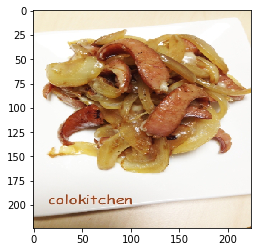

[56  5  8 30  0  0  0  0  0  0  0  0  0  0  0  0]
img 103: ['みりん', 'わさび', 'オリーブオイル', 'ゴマ油', 'タコ', 'ニンニク', 'ベビーリーフ', 'レモン', '味噌', '塩', '辛子', '醤油']
true : ['ちくわ', 'ねぎ', 'ゴマ', 'ゴマ油']
IoU: 0.06666666666666667


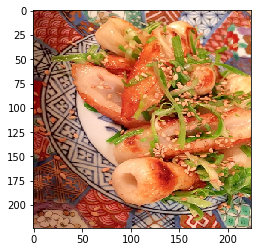

[ 16  13   2  90 109  14   0   0   0   0   0   0   0   0   0   0]
img 104: ['みりん', 'オリーブオイル', 'ニンニク', 'マジックソルト', '砂糖', '醤油']
true : ['サラダ油', 'マヨネーズ', '塩', '海苔', '玉ねぎ', '薄力粉']
IoU: 0.0


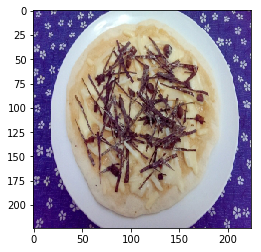

[  3 122   1   5 206  60  30   0   0   0   0   0   0   0   0   0]
img 105: ['こんにゃく', 'ねぎ', 'みりん', 'ゴマ油', 'タコ', 'ニンニク', '一味唐辛子', '大根', '日本酒', '砂糖', '豚肉', '醤油', '麺つゆ']
true : ['こんにゃく', 'たけのこ', 'コチュジャン', 'ゴマ', 'ゴマ油', '砂糖', '醤油']
IoU: 0.25


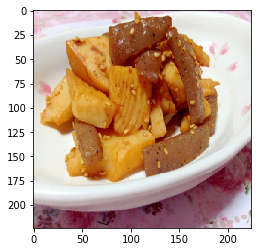

[105  25   6  57  41  59  15   1  79  13   0   0   0   0   0   0]
img 106: ['ポン酢', '塩', '料理酒', '白菜']
true : ['にんじん', 'もやし', 'オイスターソース', 'キャノーラ油', 'ピーマン', '塩コショウ', '片栗粉', '玉ねぎ', '醤油', '鶏ガラスープの素']
IoU: 0.0


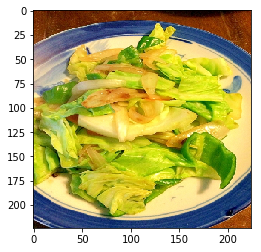

[ 52   6   1 162   4   7 186  29   0   0   0   0   0   0   0   0]
img 107: ['えのき', 'しめじ', 'なんこつ', 'ウインナー', 'キムチ', 'ケチャップ', 'ゴマ油', 'サラダ油', 'ベーコン', '粉チーズ', '豚肉']
true : ['ウスターソース', 'オリーブオイル', 'ケチャップ', 'ニンニク', '塩コショウ', '小麦粉', '舞茸', '醤油']
IoU: 0.05555555555555555


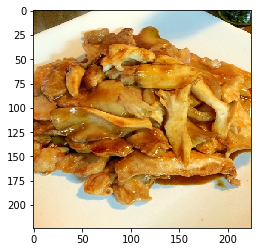

[ 3  1 13  0  0  0  0  0  0  0  0  0  0  0  0  0]
img 108: ['とろけるチーズ', 'みりん', 'ソース', 'ニンニク', 'パン粉', '卵', '料理酒', '生姜', '砂糖', '醤油']
true : ['玉ねぎ', '砂糖', '醤油']
IoU: 0.18181818181818182


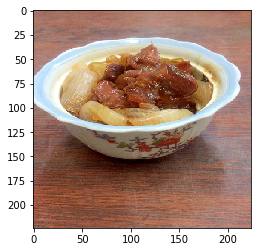

[ 25   8  15 174   2  11 206   7  99   0   0   0   0   0   0   0]
img 109: ['じゃがいも', 'だしの素', 'みりん', 'マヨネーズ', '卵', '塩', '白菜', '砂糖', '酢', '青じそ']
true : ['たけのこ', 'にんじん', 'ねぎ', 'アスパラ', 'オリーブオイル', 'ホタテ', '卵', '塩', '片栗粉']
IoU: 0.11764705882352941


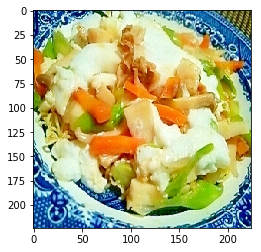

[ 16  63 143  22   8  10   0   0   0   0   0   0   0   0   0   0]
img 110: ['みりん', 'オリーブオイル', 'トマト', 'ニンニク', 'バター', 'パセリ', '塩', '塩コショウ', '大葉', '小麦粉', '砂糖', '醤油']
true : ['だし醤油', 'ねぎ', 'サラダ油', 'シイタケ', 'レモン', '生姜']
IoU: 0.0


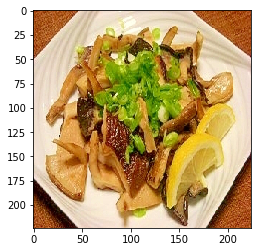

[ 3 25  1 84  5 30  0  0  0  0  0  0  0  0  0  0]
img 111: ['ごぼう', 'にんじん', 'みりん', 'ゴマ', 'ゴマ油', '塩', '玉ねぎ', '白ごま', '砂糖', '醤油']
true : ['ごぼう', 'にんじん', 'ゴマ', 'ゴマ油', '砂糖', '醤油']
IoU: 0.6


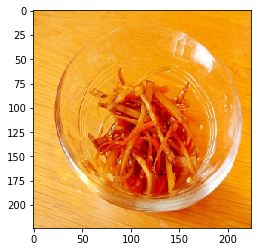

[ 27  28   8   1  80 161 136  14   0   0   0   0   0   0   0   0]
img 112: ['オリーブオイル', 'ズッキーニ', 'ニンニク', 'バター', '卵', '塩', '塩コショウ', '小麦粉', '昆布', '粉チーズ', '醤油', '黒胡椒']
true : ['ねぎ', 'キュウリ', 'マヨネーズ', '味の素', '大根', '納豆', '醤油', '青海苔']
IoU: 0.05263157894736842


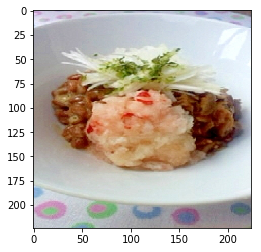

[11  2  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
img 113: ['ゴマ油', 'バター', 'レモン', '刺身', '塩', '昆布', '湯葉', '白子', '醤油']
true : ['卵', '塩']
IoU: 0.1


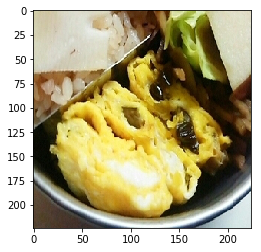

[ 27   6   8   7 186   0   0   0   0   0   0   0   0   0   0   0]
img 114: ['だしの素', 'ニラ', '塩', '大根', '大葉', '生姜', '鶏皮', '鶏肉']
true : ['ねぎ', 'オリーブオイル', '塩コショウ', '大根', '舞茸']
IoU: 0.08333333333333333


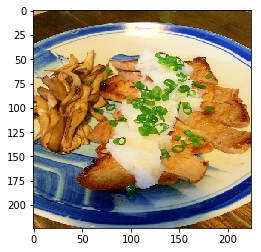

[11 15  2  0  0  0  0  0  0  0  0  0  0  0  0  0]
img 115: ['こしょう', 'にんじん', 'オリーブオイル', 'チーズ', 'レモン', '三温糖', '卵', '味噌', '塩', '玉ねぎ']
true : ['卵', '塩', '片栗粉']
IoU: 0.18181818181818182


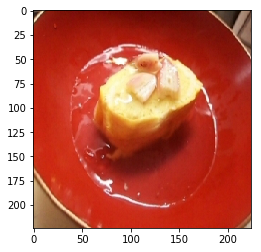

[83  1  5  9 30  0  0  0  0  0  0  0  0  0  0  0]
img 116: ['ねぎ', '塩', '生クリーム', '鰹節', '麺つゆ', '黒胡椒']
true : ['みりん', 'ゴマ', 'ゴマ油', '唐辛子', '醤油']
IoU: 0.0


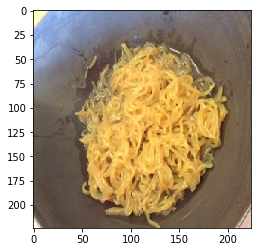

[  3  58   1   5 113   9 116   0   0   0   0   0   0   0   0   0]
img 117: ['みりん', 'ゴマ油', 'ニンニク', '塩', '枝豆', '砂糖', '醤油', '麺つゆ']
true : ['みりん', 'ガーリックパウダー', 'ゴマ油', '枝豆', '白ごま', '砂糖', '醤油']
IoU: 0.5


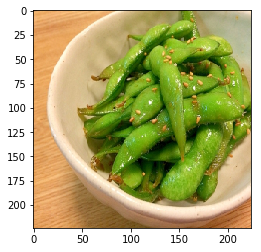

[25 17 15  2 12 11  0  0  0  0  0  0  0  0  0  0]
img 118: ['だしの素', 'みりん', 'わさび', 'チーズ', 'マヨネーズ', '塩', '大根', '大葉', '梅酢', '砂糖', '豆腐', '醤油', '青じそ']
true : ['だしの素', 'にんじん', '卵', '塩', '片栗粉', '黒胡椒']
IoU: 0.11764705882352941


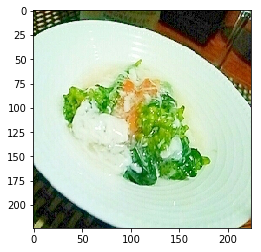

[ 7 42  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
img 119: ['みりん', 'ゴマ', 'サラダ油', 'ニンニク', 'パン粉', '刺身', '卵', '塩', '湯葉', '片栗粉', '玉ねぎ', '生姜', '薄力粉', '酢', '麺つゆ', '黒胡椒']
true : ['オリーブオイル', 'パセリ']
IoU: 0.0


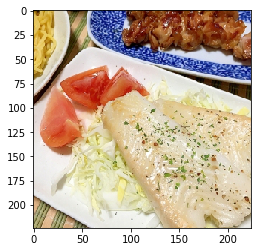

[ 3 49 17  1  5  9  0  0  0  0  0  0  0  0  0  0]
img 120: ['さつま揚げ', 'だしの素', 'みりん', 'ゴマ油', 'ナンプラー', '卵', '日本酒', '昆布', '砂糖', '醤油']
true : ['だしの素', 'みりん', 'ゴマ油', '砂糖', '醤油', '鷹の爪']
IoU: 0.45454545454545453


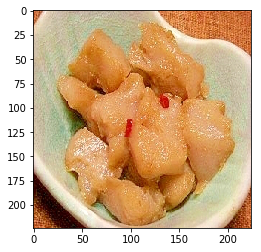

[  5 111   0   0   0   0   0   0   0   0   0   0   0   0   0   0]
img 121: ['ちくわ', 'とろけるチーズ', 'ねぎ', 'キムチ', 'ゴマ油', 'ラー油', '卵', '厚揚げ', '味噌', '生姜', '豆腐', '酢', '醤油']
true : ['キムチ', 'ゴマ油']
IoU: 0.15384615384615385


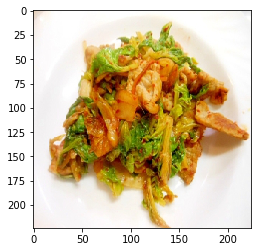

[185   4   1  20   0   0   0   0   0   0   0   0   0   0   0   0]
img 122: ['ねぎ', 'イカ', 'キャベツ', 'ゴマ油', 'バター', 'パセリ', 'ポン酢', '卵', '塩', '塩コショウ', '粉チーズ', '鶏肉', '黒胡椒']
true : ['アサリ', 'ニンニク', 'バター', '醤油']
IoU: 0.0625


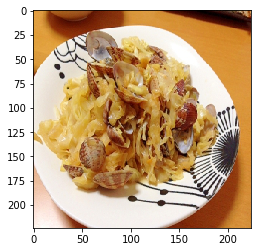

[33  8  2  0  0  0  0  0  0  0  0  0  0  0  0  0]
img 123: ['だしの素', 'キャベツ', 'マヨネーズ', '塩コショウ', '玉ねぎ', '醤油', '青じそ']
true : ['じゃがいも', 'ねぎ', '塩']
IoU: 0.0


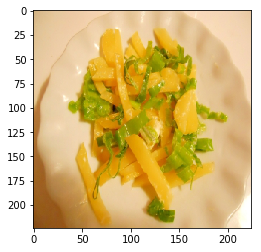

[ 75   2  12   4   7 186  29   0   0   0   0   0   0   0   0   0]
img 124: ['みりん', 'ゴマ油', 'セロリ', 'トマト', '塩コショウ', '砂糖', '醤油', '鶏皮']
true : ['オリーブオイル', 'ニンニク', '塩', '小麦粉', '牡蠣', '舞茸', '黒胡椒']
IoU: 0.0


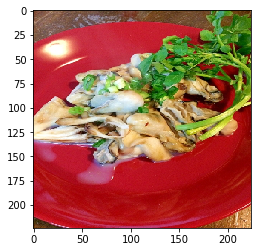

[105  39  25   6  41 162  13   0   0   0   0   0   0   0   0   0]
img 125: ['みりん', 'オイスターソース', 'ニンニク', '塩', '塩コショウ', '生姜', '醤油', '鶏肉', '黒胡椒']
true : ['にんじん', 'ウスターソース', 'キャノーラ油', 'ピーマン', '塩コショウ', '玉ねぎ', '豚肉']
IoU: 0.06666666666666667


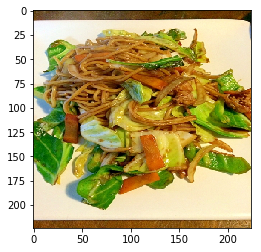

[ 1 71  8 10  0  0  0  0  0  0  0  0  0  0  0  0]
img 126: ['ねぎ', 'チーズ', '厚揚げ', '塩', '小麦粉', '生姜', '醤油']
true : ['ねぎ', '厚揚げ', '生姜', '醤油']
IoU: 0.5714285714285714


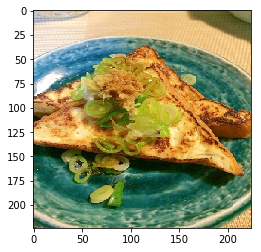

[208   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0]
img 127: ['じゃがいも', 'だしの素', 'ねぎ', 'ゴマ油', '塩コショウ', '片栗粉', '砂糖', '醤油']
true : ['マーガリン']
IoU: 0.0


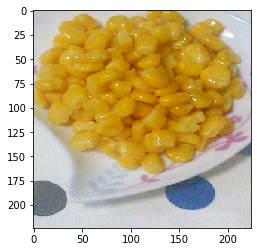

[48 33  6 31  9  0  0  0  0  0  0  0  0  0  0  0]
img 128: ['こしょう', 'オリーブオイル', 'コンソメ', 'チーズ', 'トマト', 'パン粉', 'マヨネーズ', 'レモン', 'ローズマリー', '塩', '塩コショウ', '炒め用油', '白ワイン', '砂糖', '豚肉', '鶏むね肉', '鶏肉', '黒胡椒']
true : ['じゃがいも', 'みりん', 'キャベツ', 'ポン酢', '塩コショウ']
IoU: 0.045454545454545456


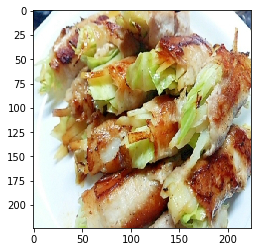

[16  6  8 31  0  0  0  0  0  0  0  0  0  0  0  0]
img 129: ['サラダ油', 'ニンニク', 'パセリ', '卵', '塩コショウ', '小麦粉', '海苔', '片栗粉', '玉ねぎ', '砂糖', '酢', '鶏肉']
true : ['ねぎ', 'サラダ油', 'ポン酢', '塩コショウ']
IoU: 0.14285714285714285


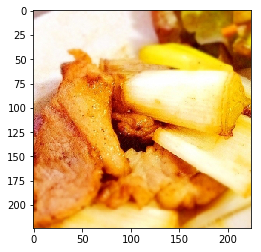

[  6 174  45  14   7   0   0   0   0   0   0   0   0   0   0   0]
img 130: ['塩', '枝豆']
true : ['アスパラ', 'オリーブオイル', 'ベーコン', 'マヨネーズ', '塩コショウ']
IoU: 0.0


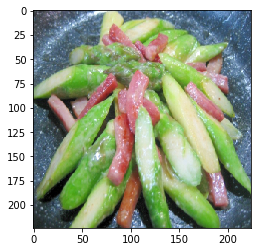

[117  33   7  14   0   0   0   0   0   0   0   0   0   0   0   0]
img 131: ['にんじん', 'サラダ油', 'トマト', 'バジル', 'マヨネーズ', '卵', '塩', '塩コショウ', '醤油', '鮭', '黒胡椒']
true : ['じゃがいも', 'オリーブオイル', 'マヨネーズ', '焼肉のたれ']
IoU: 0.07142857142857142


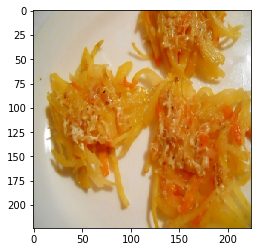

[84 15  2  0  0  0  0  0  0  0  0  0  0  0  0  0]
img 132: ['塩', '塩コショウ', '砂糖', '醤油']
true : ['ごぼう', '塩', '片栗粉']
IoU: 0.16666666666666666


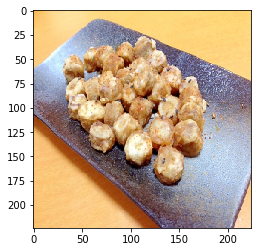

[ 3 25 56 26  1 59  5  0  0  0  0  0  0  0  0  0]
img 133: ['ねぎ', 'みりん', '塩コショウ', '大根', '大葉', '料理酒', '砂糖', '醤油']
true : ['こしょう', 'ちくわ', 'にんじん', 'オイスターソース', 'ゴマ油', '砂糖', '醤油']
IoU: 0.15384615384615385


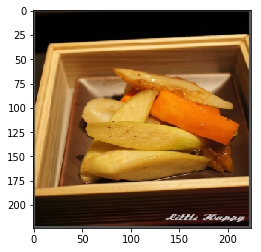

[149   1  57   5   4   0   0   0   0   0   0   0   0   0   0   0]
img 134: ['みりん', '大根', '醤油']
true : ['わかめ', 'ゴマ油', 'ニンニク', '醤油', '鶏ガラスープの素']
IoU: 0.14285714285714285


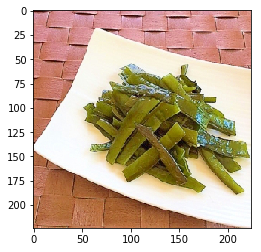

[4 6 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
img 135: ['エリンギ', 'オリーブオイル', 'ガーリック', 'ホタテ', 'マジックソルト', '塩', '砂糖', '酢', '醤油']
true : ['ニンニク', '塩コショウ']
IoU: 0.0


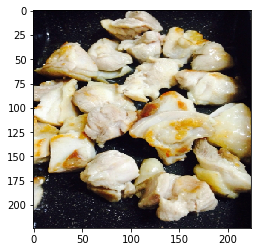

[46 26 15 59  5 10  0  0  0  0  0  0  0  0  0  0]
img 136: ['こめ油', 'しめじ', 'マヨネーズ', '卵', '塩', '柚子こしょう', '醤油']
true : ['こしょう', 'しめじ', 'オイスターソース', 'ゴマ油', '片栗粉', '生姜']
IoU: 0.08333333333333333


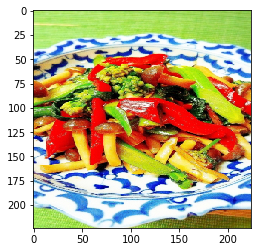

[16 91  8 80 90 96  0  0  0  0  0  0  0  0  0  0]
img 137: ['こしょう', 'じゃがいも', 'パン粉', 'ローズマリー', '卵', '塩', '塩コショウ', '小麦粉', '醤油', '鶏むね肉', '鶏肉']
true : ['ねぎ', 'サラダ油', 'タコ', '海苔', '長芋', '青海苔']
IoU: 0.0


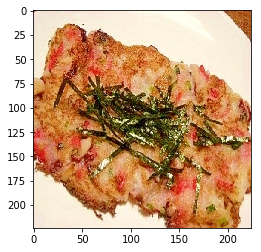

[ 63   3  25  18 260  56  17   8   1  84   0   0   0   0   0   0]
img 138: ['卵', '塩', '生姜', '粉チーズ', '黒胡椒']
true : ['おから', 'ごぼう', 'だしの素', 'ちくわ', 'にんじん', 'ねぎ', 'シイタケ', '砂糖', '酢', '醤油']
IoU: 0.0


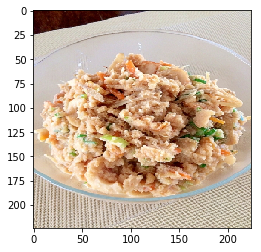

[ 33   6  12 211   4   0   0   0   0   0   0   0   0   0   0   0]
img 139: ['えんどう豆', 'オリーブオイル', 'ケチャップ', 'ズッキーニ', 'チーズ', 'トマト', 'ニンニク', 'ピーマン', 'ベビーリーフ', 'マヨネーズ', '塩コショウ', '玉ねぎ', '醤油', '鷹の爪', '黒胡椒']
true : ['じゃがいも', 'ニンニク', '塩コショウ', '菜の花', '黒胡椒']
IoU: 0.17647058823529413


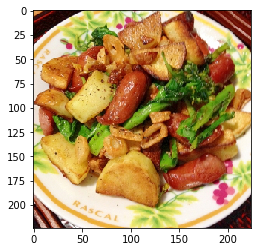

[  3  32 143  10   9  21   0   0   0   0   0   0   0   0   0   0]
img 140: ['みりん', 'ゴマ油', 'サラダ油', '塩', '塩昆布', '日本酒', '生姜', '砂糖', '秋刀魚', '醤油', '鮎']
true : ['だし醤油', 'みりん', '日本酒', '生姜', '砂糖', '麺つゆ']
IoU: 0.3076923076923077


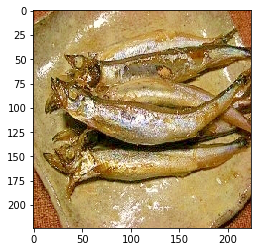

[  5  12 236   2   0   0   0   0   0   0   0   0   0   0   0   0]
img 141: ['キュウリ', 'ゴマ', 'ニンニク', 'マヨネーズ', 'レモン', '砂糖', '醤油', '鮎', '黒胡椒']
true : ['ゴマ油', '塩', '縮緬雑魚', '黒胡椒']
IoU: 0.08333333333333333


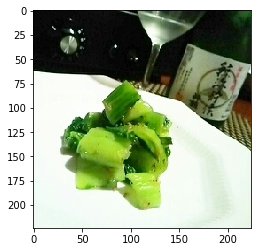

[ 69   2  11 109   7  21 164   0   0   0   0   0   0   0   0   0]
img 142: ['たらこ', '長芋', '黒胡椒']
true : ['はちみつ', 'オリーブオイル', '卵', '塩', '日本酒', '薄力粉', '豆乳']
IoU: 0.0


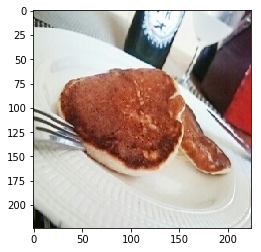

[158  37  15   8   5  11  23   0   0   0   0   0   0   0   0   0]
img 143: ['こしょう', 'ねぎ', 'チーズ', 'パン粉', 'ヨーグルト', '卵', '塩', '塩コショウ', '小麦粉', '揚げ油', '玉ねぎ', '醤油']
true : ['ねぎ', 'ゴマ油', '卵', '味噌', '片栗粉', '豆腐', '鶏ひき肉']
IoU: 0.11764705882352941


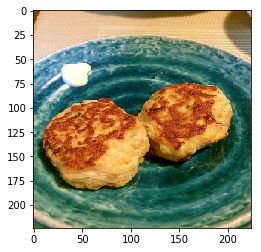

[ 25  74  41   8   2  15 110  11  64   0   0   0   0   0   0   0]
img 144: ['だしの素', 'はちみつ', 'ゴマ油', 'ヨーグルト', '塩', '塩コショウ']
true : ['ご飯', 'にんじん', 'ねぎ', 'エリンギ', 'ピーマン', '卵', '塩', '片栗粉', '白子']
IoU: 0.07142857142857142


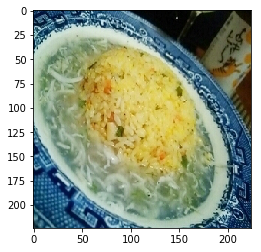

[84 15  2 16  0  0  0  0  0  0  0  0  0  0  0  0]
img 145: ['塩', '落花生']
true : ['ごぼう', 'サラダ油', '塩', '片栗粉']
IoU: 0.2


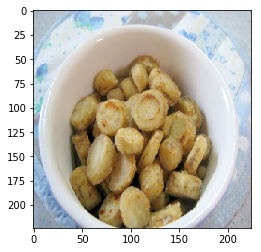

[9 7 1 0 0 0 0 0 0 0 0 0 0 0 0 0]
img 146: ['ゴマ油', 'サラダ油', '塩', '醤油']
true : ['みりん', 'オリーブオイル', '醤油']
IoU: 0.16666666666666666


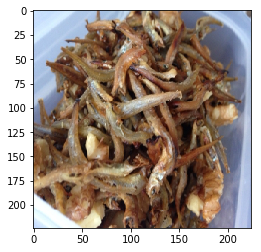

[ 42   6  46 106   7   0   0   0   0   0   0   0   0   0   0   0]
img 147: ['かぼちゃ', 'みりん', 'パン粉', '味噌', '塩', '小麦粉', '揚げ油', '豆腐', '酒粕', '醤油', '鮭']
true : ['しめじ', 'オリーブオイル', 'パセリ', '塩コショウ', '粒マスタード']
IoU: 0.0


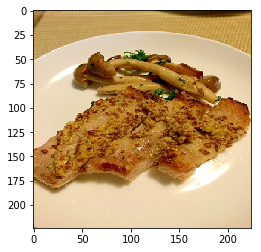

[56  6  8 12 11  7  0  0  0  0  0  0  0  0  0  0]
img 148: ['みりん', 'サラダ油', 'ニンニク', '一味唐辛子', '卵', '塩', '醤油']
true : ['ちくわ', 'ねぎ', 'オリーブオイル', '卵', '塩コショウ', '黒胡椒']
IoU: 0.08333333333333333


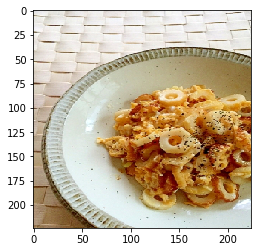

[33  6 68 12 36  0  0  0  0  0  0  0  0  0  0  0]
img 149: ['とろけるチーズ', 'はんぺん', 'インスタントドライイースト', 'オリーブオイル', 'クレイジーソルト', 'チーズ', 'ドライパセリ', 'ニンニク', 'ハム', 'バター', 'マヨネーズ', '塩', '強力粉', '砂糖', '黒胡椒']
true : ['じゃがいも', 'とろけるチーズ', '塩コショウ', '餃子の皮', '黒胡椒']
IoU: 0.1111111111111111


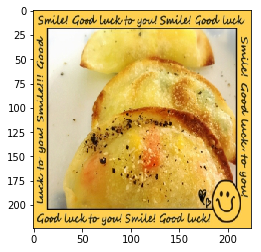

[  7  49   6 128   0   0   0   0   0   0   0   0   0   0   0   0]
img 150: ['ほうれん草', 'オリーブオイル', 'マヨネーズ', '味噌', '塩', '菜の花', '醤油', '黒胡椒']
true : ['オリーブオイル', '塩コショウ', '小松菜', '鷹の爪']
IoU: 0.09090909090909091


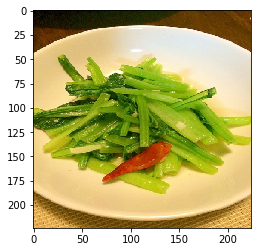

[17  2 80 11  9  0  0  0  0  0  0  0  0  0  0  0]
img 151: ['だしの素', 'にんじん', 'アスパラ', 'ゴマ油', 'レモン', '塩', '梅酢', '豆腐', '酒粕', '黒胡椒']
true : ['だしの素', 'みりん', '卵', '塩', '青海苔']
IoU: 0.15384615384615385


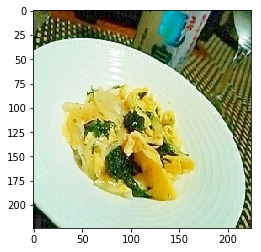

[27 15  1  2  8  5  0  0  0  0  0  0  0  0  0  0]
img 152: ['こしょう', 'オリーブオイル', 'シイタケ', 'ベーコン', 'マヨネーズ', '卵', '塩', '塩コショウ', '小麦粉', '揚げ油']
true : ['ねぎ', 'ゴマ油', '塩', '大根', '片栗粉', '醤油']
IoU: 0.06666666666666667


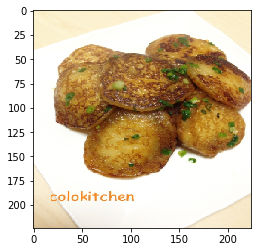

[52  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
img 153: ['はちみつ', 'みりん', 'ソース', 'ベーコン', '小麦粉', '揚げ油', '砂糖', '醤油', '鶏肉']
true : ['ケチャップ']
IoU: 0.0


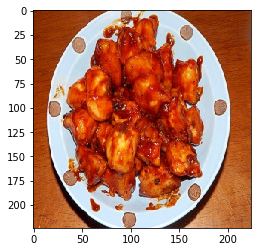

[ 48  57   2  10   7 116  53   0   0   0   0   0   0   0   0   0]
img 154: ['しめじ', 'にんじん', 'オリーブオイル', 'キャベツ', 'ゴマ油', 'ザーサイ', 'セロリ', 'ベーコン', '塩', '塩コショウ', '白菜', '醤油', '黒胡椒']
true : ['イカ', 'オリーブオイル', 'ガーリックパウダー', 'キャベツ', '塩', '生姜', '鶏ガラスープの素']
IoU: 0.17647058823529413


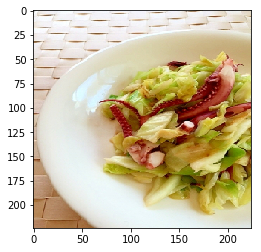

[169 231  24   0   0   0   0   0   0   0   0   0   0   0   0   0]
img 155: ['オリーブオイル', 'ナンプラー', 'パクチー', '刺身', '塩', '大葉', '玉ねぎ', '生姜', '酢', '醤油', '鯵']
true : ['チリソース', 'ナンプラー', '鶏肉']
IoU: 0.07692307692307693


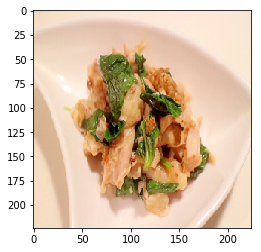

[33 15  2 19 34  0  0  0  0  0  0  0  0  0  0  0]
img 156: ['こしょう', 'ウインナー', 'サラダ油', 'ベーコン', 'マヨネーズ', '卵', '塩', '小麦粉', '砂糖', '麩']
true : ['じゃがいも', 'チーズ', '塩', '揚げ油', '片栗粉']
IoU: 0.07142857142857142


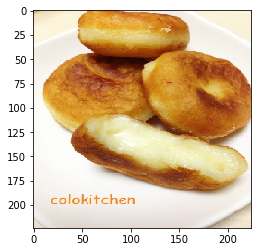

[27 17  1 20  2  9  0  0  0  0  0  0  0  0  0  0]
img 157: ['たらこ', 'はちみつ', 'バター', '塩', '大根', '玉ねぎ', '赤ワイン', '醤油']
true : ['だしの素', 'みりん', 'バター', '塩', '大根', '醤油']
IoU: 0.4


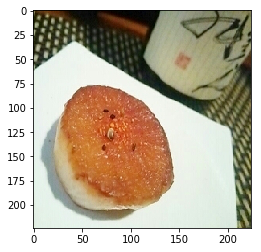

[105  40  39  48   6  41  80 162  13   0   0   0   0   0   0   0]
img 158: ['こしょう', 'ねぎ', 'ゴマ油', '塩', '酢', '醤油']
true : ['ウスターソース', 'キャノーラ油', 'キャベツ', 'ピーマン', '塩コショウ', '玉ねぎ', '豚肉', '青海苔', '鰹節']
IoU: 0.0


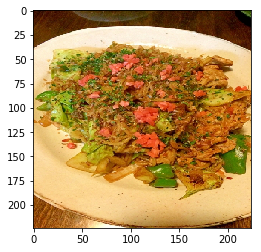

[ 6 24 11  7 29  0  0  0  0  0  0  0  0  0  0  0]
img 159: ['レモン', '塩', '塩コショウ', '小麦粉', '揚げ油', '鱧']
true : ['オリーブオイル', '卵', '塩コショウ', '小麦粉', '鶏肉']
IoU: 0.2222222222222222


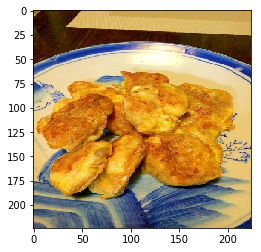

[ 88   7   6 156   0   0   0   0   0   0   0   0   0   0   0   0]
img 160: ['じゃがいも', 'エビ', 'オリーブオイル', 'ズッキーニ', 'チーズ', 'トマト', 'ニンニク', 'バジル', '塩', '塩コショウ', '牛乳', '白ワイン', '黒胡椒']
true : ['オリーブオイル', 'カレー粉', '塩コショウ', '砂肝']
IoU: 0.13333333333333333


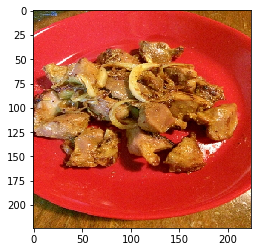

[23  3 39 41  2  5 10  9  4  0  0  0  0  0  0  0]
img 161: ['かぼちゃ', 'みりん', 'ニンニク', '塩', '塩コショウ', '揚げ油', '砂糖', '醤油']
true : ['みりん', 'ゴマ油', 'ニンニク', 'ピーマン', '味噌', '塩', '生姜', '砂糖', '豚肉']
IoU: 0.3076923076923077


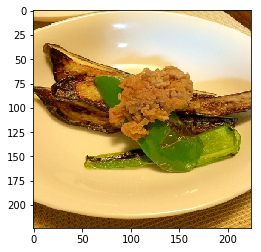

[99 31 20  0  0  0  0  0  0  0  0  0  0  0  0  0]
img 162: ['わさび', '刺身', '塩', '醤油']
true : ['バター', 'ホタテ', 'ポン酢']
IoU: 0.0


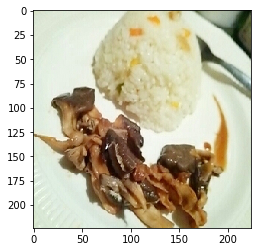

[ 3 25  5 10 30  0  0  0  0  0  0  0  0  0  0  0]
img 163: ['だしの素', 'ねぎ', 'みりん', 'ゴマ油', '海苔', '砂糖', '醤油']
true : ['にんじん', 'ゴマ', 'ゴマ油', '生姜', '砂糖']
IoU: 0.2


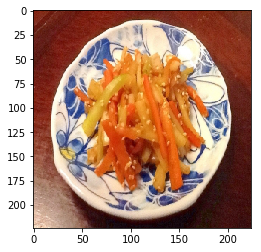

[ 50 125  15   8  71  10 231   0   0   0   0   0   0   0   0   0]
img 164: ['わさび', 'オリーブオイル', 'ベーコン', '塩', '海苔', '砂糖', '醤油', '長芋', '鰹節', '麺つゆ']
true : ['ねぎ', 'エビ', 'チリソース', '厚揚げ', '水菜', '片栗粉', '生姜']
IoU: 0.0


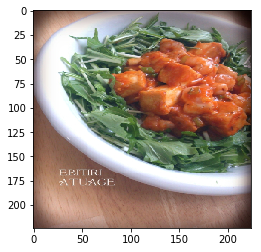

[68 19  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
img 165: ['オリーブ油', 'ガーリックパウダー', 'ゴマ油', '卵', '塩', '塩コショウ', '小麦粉', '揚げ油', '黒胡椒']
true : ['チーズ', '餃子の皮']
IoU: 0.0


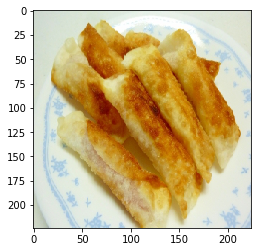

[17 11 19  2  0  0  0  0  0  0  0  0  0  0  0  0]
img 166: ['さつまいも', 'ちくわ', 'みりん', 'りんご', 'カニ', '塩', '日本酒', '砂糖', '醤油']
true : ['だしの素', 'チーズ', '卵', '塩']
IoU: 0.08333333333333333


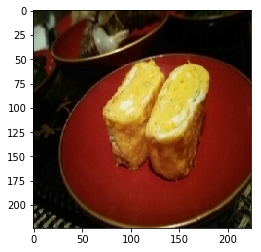

[ 16  72 190   2  68  62   0   0   0   0   0   0   0   0   0   0]
img 167: ['こしょう', 'サラダ油', '卵', '大根', '砂糖', '鶏肉', '麺つゆ', '黒胡椒']
true : ['コンソメ', 'サラダ油', '三温糖', '塩', '粉チーズ', '餃子の皮']
IoU: 0.07692307692307693


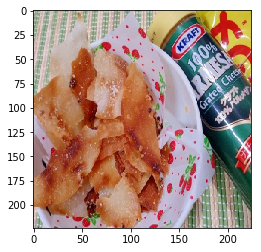

[ 1  8 14  0  0  0  0  0  0  0  0  0  0  0  0  0]
img 168: ['エリンギ', 'キュウリ', 'サラダ油', 'ニンニク', 'マヨネーズ', '塩', '塩コショウ', '大根', '小麦粉', '片栗粉', '牛乳', '玉ねぎ', '生クリーム', '砂糖', '鶏肉']
true : ['ねぎ', 'マヨネーズ', '醤油']
IoU: 0.058823529411764705


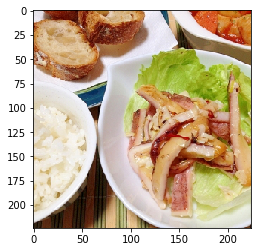

[26  1 24 59  2 15  4  0  0  0  0  0  0  0  0  0]
img 169: ['こんにゃく', 'しめじ', 'ねぎ', 'トマト', 'ニンニク', 'ポン酢', '塩', '塩コショウ', '大根', '生姜', '白子', '砂糖', '醤油']
true : ['こしょう', 'オイスターソース', 'ニンニク', '塩', '片栗粉', '醤油', '鶏肉']
IoU: 0.17647058823529413


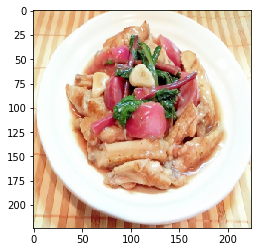

[50  3 52  2 14  4  7 29  0  0  0  0  0  0  0  0]
img 170: ['バター', 'マヨネーズ', '塩', '塩コショウ', '大葉', '梅干し', '酢', '醤油']
true : ['エビ', 'オリーブオイル', 'ケチャップ', 'ニンニク', 'マヨネーズ', '塩', '小麦粉', '砂糖']
IoU: 0.14285714285714285


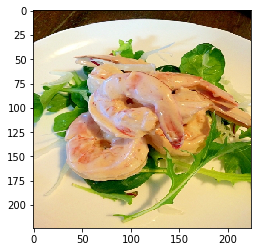

[ 39   6  41 106   7  29   0   0   0   0   0   0   0   0   0   0]
img 171: ['じゃがいも', 'オリーブオイル', 'ガーリック', 'コンソメ', 'バルサミコ酢', 'マジックソルト', '塩', '塩コショウ', '粉チーズ', '豚肉', '赤ワイン', '鶏肉', '黒胡椒']
true : ['オリーブオイル', 'ピーマン', '塩コショウ', '小麦粉', '粒マスタード', '豚肉']
IoU: 0.1875


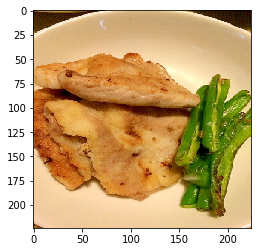

[ 6 33 20  0  0  0  0  0  0  0  0  0  0  0  0  0]
img 172: ['だしの素', 'みりん', 'ケチャップ', 'サラダ油', 'マヨネーズ', '卵', '塩', '塩コショウ', '揚げ油', '片栗粉', '酢', '醤油', '黒胡椒']
true : ['じゃがいも', 'バター', '塩コショウ']
IoU: 0.06666666666666667


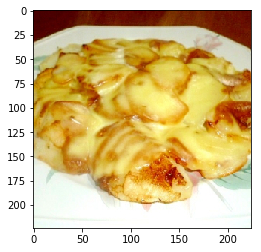

[15 11  1 13  0  0  0  0  0  0  0  0  0  0  0  0]
img 173: ['ゴマ', 'サラダ油', '刺身', '卵', '塩', '揚げ油', '片栗粉', '生姜', '醤油']
true : ['卵', '片栗粉', '玉ねぎ', '醤油']
IoU: 0.3


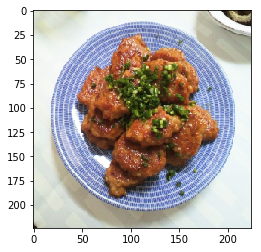

[10  1  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
img 174: ['だしの素', 'パスタ', '塩', '生姜', '醤油']
true : ['生姜', '醤油']
IoU: 0.4


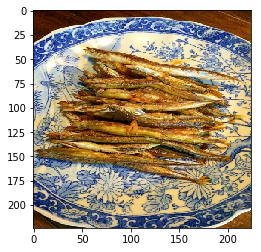

[ 44  40  65   1 127   0   0   0   0   0   0   0   0   0   0   0]
img 175: ['オリーブオイル', '味噌', '塩', '玉ねぎ', '黒胡椒']
true : ['わさび', '油揚げ', '酒粕', '醤油', '鰹節']
IoU: 0.0


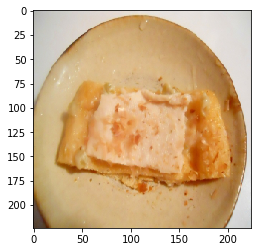

[ 3  1  2  5 10 82  0  0  0  0  0  0  0  0  0  0]
img 176: ['じゃがいも', 'みりん', 'ゴマ油', '味噌', '塩', '大根']
true : ['ゴマ油', '塩', '生姜', '砂糖', '豆板醤', '醤油']
IoU: 0.2


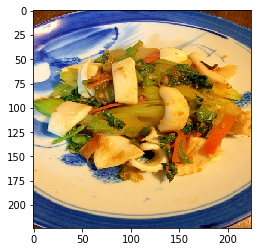

[ 38 119   6   7  29   0   0   0   0   0   0   0   0   0   0   0]
img 177: ['オリーブ油', '塩', '揚げ油', '辛子', '醤油']
true : ['オリーブオイル', '塩コショウ', '大葉', '小麦粉', '梅干し']
IoU: 0.0


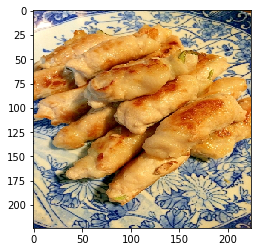

[18  6 31 45 14 76  7  0  0  0  0  0  0  0  0  0]
img 178: ['こんにゃく', 'イカ', 'オリーブオイル', 'ニンニク', 'バター', '味噌', '塩', '梅干し', '醤油', '鰹', '黒胡椒']
true : ['オリーブオイル', 'ベーコン', 'ポン酢', 'マヨネーズ', 'レンコン', '塩コショウ', '酢']
IoU: 0.058823529411764705


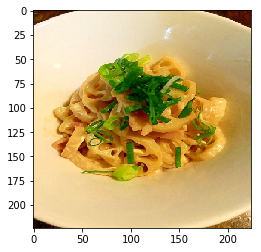

[ 16   3 143  51   8  15   1  21   0   0   0   0   0   0   0   0]
img 179: ['ねぎ', 'みりん', '味噌', '塩', '砂糖', '豚肉', '酢', '醤油']
true : ['だし醤油', 'ねぎ', 'サラダ油', '七味唐辛子', '日本酒', '片栗粉', '砂糖', '醤油']
IoU: 0.23076923076923078


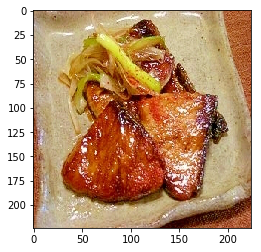

[49  1 60  0  0  0  0  0  0  0  0  0  0  0  0  0]
img 180: ['じゃがいも', 'オリーブオイル', 'カレー粉', 'コンソメ', 'チーズ', '三温糖', '刺身', '塩', '塩コショウ', '玉ねぎ', '醤油', '魚肉ソーセージ']
true : ['こんにゃく', '醤油', '鷹の爪']
IoU: 0.07142857142857142


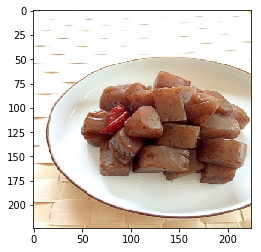

[16 97  6 81 59  5  0  0  0  0  0  0  0  0  0  0]
img 181: ['だし醤油', 'ちくわ', 'ねぎ', 'ゴマ油', 'ポン酢', '酢', '醤油']
true : ['オイスターソース', 'ゴマ油', 'サラダ油', 'ニラ', 'ハム', '塩コショウ']
IoU: 0.08333333333333333


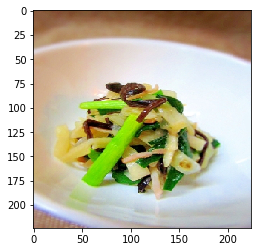

[ 35 127   2   0   0   0   0   0   0   0   0   0   0   0   0   0]
img 182: ['みりん', 'トマト', '卵', '塩', '日本酒', '醤油']
true : ['トマト', '塩', '酒粕']
IoU: 0.2857142857142857


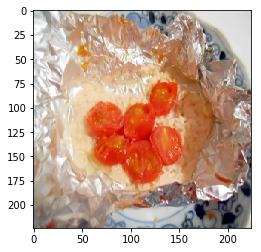

[ 48   1  11 109   7  19   0   0   0   0   0   0   0   0   0   0]
img 183: ['みりん', 'オリーブオイル', 'サラダ油', 'ニンニク', '塩', '塩コショウ', '小麦粉', '焼肉のたれ', '醤油', '黒胡椒']
true : ['オリーブオイル', 'キャベツ', 'チーズ', '卵', '薄力粉', '醤油']
IoU: 0.14285714285714285


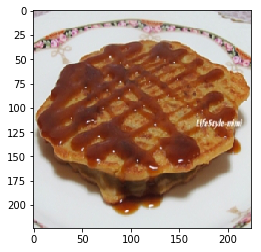

[ 5 11 57  6  0  0  0  0  0  0  0  0  0  0  0  0]
img 184: ['チーズ', '卵', '塩', '黒胡椒']
true : ['ゴマ油', '卵', '塩コショウ', '鶏ガラスープの素']
IoU: 0.14285714285714285


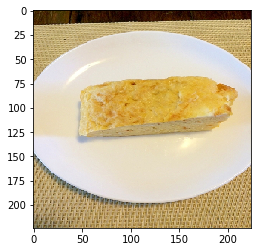

[105  39  18  48  97   6  15  59   2  57  68   1   5  10   4 102]
img 185: ['えのき', 'サラダ油', 'ズッキーニ', 'ニンニク', 'パン粉', '卵', '塩', '塩コショウ', '小麦粉', '片栗粉', '醤油', '鰹節', '黒胡椒']
true : ['オイスターソース', 'キャノーラ油', 'キャベツ', 'ゴマ油', 'ニラ', 'ニンニク', 'ラー油', '塩', '塩コショウ', '片栗粉', '生姜', '豚肉', '酢', '醤油', '餃子の皮', '鶏ガラスープの素']
IoU: 0.20833333333333334


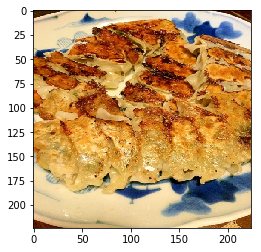

[105  27   6  31  24   8   0   0   0   0   0   0   0   0   0   0]
img 186: ['じゃがいも', 'ねぎ', 'ニンニク', '味噌', '塩コショウ', '大根', '玉ねぎ', '生姜', '醤油', '鰯']
true : ['ねぎ', 'キャノーラ油', 'ポン酢', '塩コショウ', '大根', '鶏肉']
IoU: 0.23076923076923078


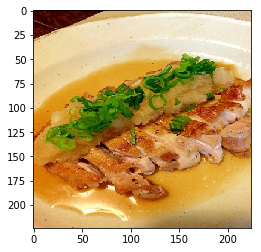

[  8 175  65   0   0   0   0   0   0   0   0   0   0   0   0   0]
img 187: ['こしょう', 'にんじん', 'パセリ', 'レモン', '塩', '塩コショウ', '枝豆', '玉ねぎ', '餃子の皮', '黒胡椒']
true : ['ねぎ', '油揚げ', '里芋']
IoU: 0.0


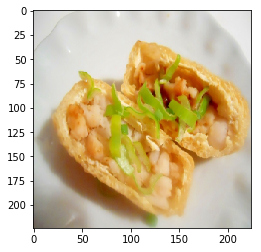

[ 40   5  36  11  13  98 111  29   0   0   0   0   0   0   0   0]
img 188: ['じゃがいも', 'バター', 'パン粉', '卵', '塩', '小麦粉', '揚げ油', '片栗粉', '玉ねぎ', '薄力粉', '酒粕']
true : ['とろけるチーズ', 'ほうれん草', 'キムチ', 'ゴマ油', '卵', '小麦粉', '玉ねぎ', '鰹節']
IoU: 0.1875


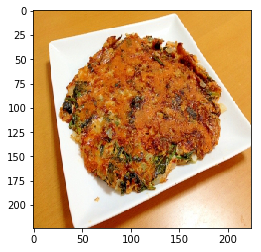

[105   6  24  80  29   0   0   0   0   0   0   0   0   0   0   0]
img 189: ['エビ', 'オリーブオイル', 'ズッキーニ', 'チーズ', 'ハーブソルト', 'ブロッコリー', 'マヨネーズ', '塩', '塩コショウ', '小麦粉', '鷹の爪', '黒胡椒']
true : ['キャノーラ油', '塩コショウ', '小麦粉', '青海苔', '鶏肉']
IoU: 0.13333333333333333


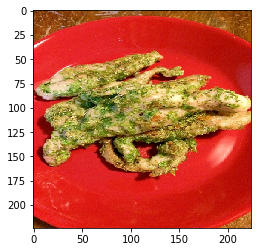

[ 16  52   6  80 161  36  29   0   0   0   0   0   0   0   0   0]
img 190: ['にんじん', 'キムチ', 'キャベツ', 'ゴマ油', 'マヨネーズ', '卵', '塩', '粉チーズ', '豆腐', '豚肉', '醤油']
true : ['とろけるチーズ', 'ケチャップ', 'サラダ油', '塩コショウ', '小麦粉', '納豆', '青海苔']
IoU: 0.0


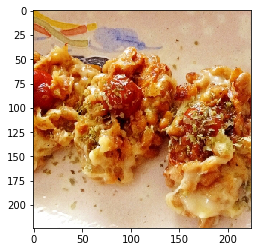

[44 31  1  2 12  0  0  0  0  0  0  0  0  0  0  0]
img 191: ['みりん', 'オリーブオイル', 'パン粉', '塩', '大根', '鶏肉', '麺つゆ']
true : ['わさび', 'ポン酢', '塩', '醤油', '黒胡椒']
IoU: 0.09090909090909091


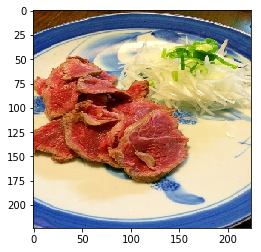

[ 6  8  1 90 11 62  0  0  0  0  0  0  0  0  0  0]
img 192: ['オリーブオイル', 'ニンニク', 'バター', 'ポン酢', 'マヨネーズ', '塩', '塩コショウ', '玉ねぎ', '粒マスタード', '鯖', '鶏肉', '麺つゆ', '黒胡椒']
true : ['ねぎ', '卵', '塩コショウ', '海苔', '粉チーズ', '醤油']
IoU: 0.05555555555555555


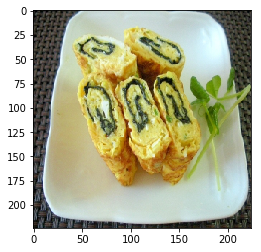

[63 56  6 14 13  0  0  0  0  0  0  0  0  0  0  0]
img 193: ['わさび', '醤油']
true : ['ちくわ', 'シイタケ', 'マヨネーズ', '塩コショウ', '玉ねぎ']
IoU: 0.0


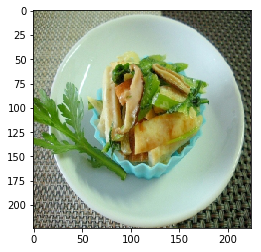

[105   6  41   1  57   5  79   0   0   0   0   0   0   0   0   0]
img 194: ['カニカマ', 'ゴマ', 'ゴマ油', 'ニンニク', '塩', '塩コショウ', '梅干し', '砂糖', '醤油']
true : ['もやし', 'キャノーラ油', 'ゴマ油', 'ピーマン', '塩コショウ', '醤油', '鶏ガラスープの素']
IoU: 0.23076923076923078


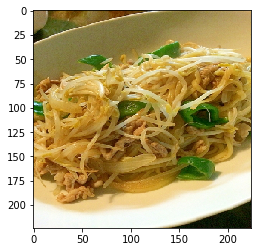

[ 85 105 120  41   0   0   0   0   0   0   0   0   0   0   0   0]
img 195: ['にんじん', 'ねぎ', 'イカ', 'オリーブオイル', 'ゴマ油', 'ニンニク', 'バター', 'パスタ', 'ポン酢', 'マヨネーズ', '塩', '塩コショウ', '醤油', '鶏肉']
true : ['ウインナー', 'キャノーラ油', 'パスタ', 'ピーマン']
IoU: 0.058823529411764705


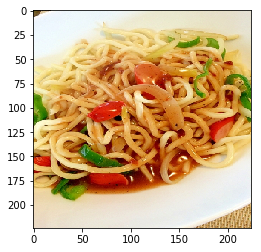

[7 6 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
img 196: ['にんじん', 'はちみつ', 'わさび', 'ゴマ油', 'マグロ', 'レモン', '塩', '日本酒', '玉ねぎ', '黒胡椒']
true : ['オリーブオイル', '塩コショウ']
IoU: 0.0


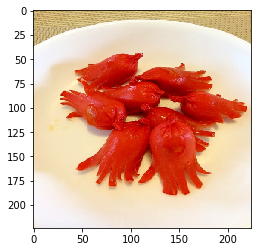

[ 1 55  2 20 86 12 45  4  7  0  0  0  0  0  0  0]
img 197: ['じゃがいも', 'ねぎ', 'イカ', 'ゴマ油', 'ホタテ', '一味唐辛子', '塩', '砂糖', '醤油']
true : ['オリーブオイル', 'ニンニク', 'バター', 'ベーコン', '塩', '白ワイン', '白菜', '醤油', '黒胡椒']
IoU: 0.125


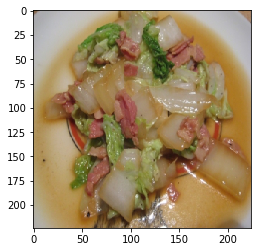

[16  3 49 33 41  1  9  0  0  0  0  0  0  0  0  0]
img 198: ['ちくわ', 'にんじん', 'ねぎ', 'みりん', 'ゴマ油', 'ピーマン', 'ラー油', '玉ねぎ', '砂糖', '醤油']
true : ['じゃがいも', 'みりん', 'サラダ油', 'ピーマン', '砂糖', '醤油', '鷹の爪']
IoU: 0.3076923076923077


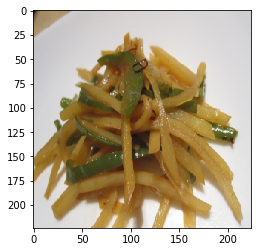

[ 46  26 198  13 191   0   0   0   0   0   0   0   0   0   0   0]
img 199: ['チーズ', '味噌', '大根', '玉ねぎ', '生ハム']
true : ['えんどう豆', 'こしょう', 'しめじ', '塩糀', '玉ねぎ']
IoU: 0.1111111111111111


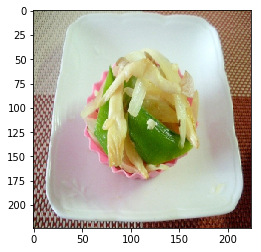

[ 3 49  1  5  9 76 30  0  0  0  0  0  0  0  0  0]
img 200: ['塩', '酢', '黒胡椒']
true : ['みりん', 'ゴマ', 'ゴマ油', 'レンコン', '砂糖', '醤油', '鷹の爪']
IoU: 0.0


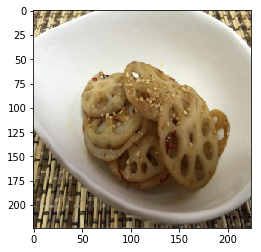

[ 3 18 49  8  1  9  7  0  0  0  0  0  0  0  0  0]
img 201: ['オリーブオイル', 'ゴマ油', 'バター', '刺身', '砂糖', '醤油', '黒胡椒']
true : ['ねぎ', 'みりん', 'オリーブオイル', '砂糖', '酢', '醤油', '鷹の爪']
IoU: 0.2727272727272727


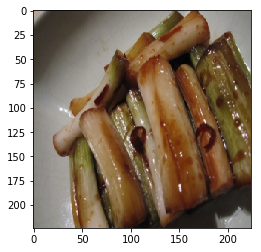

[ 68 120   0   0   0   0   0   0   0   0   0   0   0   0   0   0]
img 202: ['ねぎ', 'はちみつ', 'オリーブオイル', 'サラダ油', 'チーズ', 'マヨネーズ', '七味唐辛子', '塩', '揚げ油', '薄力粉', '醤油', '長芋', '黒胡椒']
true : ['ウインナー', '餃子の皮']
IoU: 0.0


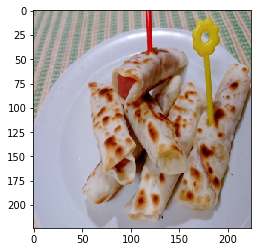

[ 35   6 112  13 128   0   0   0   0   0   0   0   0   0   0   0]
img 203: ['こしょう', 'ねぎ', 'オリーブ油', 'キュウリ', 'ケチャップ', 'チーズ', 'トマト', 'レモン', '塩コショウ', '玉ねぎ', '醤油']
true : ['ツナ', 'トマト', '塩コショウ', '小松菜', '玉ねぎ']
IoU: 0.23076923076923078


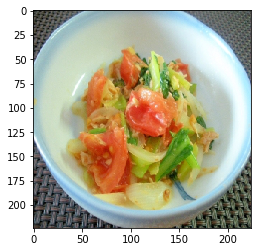

[142  46   6  31 214  13   0   0   0   0   0   0   0   0   0   0]
img 204: ['ご飯', 'しめじ', '塩', '大根', '大葉', '日本酒', '玉ねぎ', '白ワイン', '酢']
true : ['しめじ', 'パプリカ', 'ポン酢', '塩コショウ', '玉ねぎ', '鰆']
IoU: 0.15384615384615385


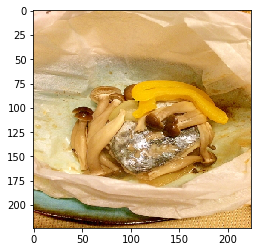

[39  6  1  5 79  0  0  0  0  0  0  0  0  0  0  0]
img 205: ['ゴマ', 'ゴマ油', 'ニンニク', '塩', '生クリーム', '白菜', '鰹節', '鷹の爪', '黒胡椒']
true : ['もやし', 'ゴマ油', '塩コショウ', '豚肉', '醤油']
IoU: 0.07692307692307693


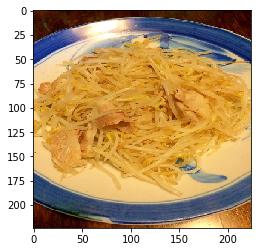

[ 52   6   8 157 205  10 162   4   7 231   0   0   0   0   0   0]
img 206: ['こしょう', 'みりん', 'トマト', 'ニンニク', '塩', '塩コショウ', '焼肉のたれ', '牛肉', '生姜', '砂糖', '赤ワイン', '醤油', '鶏肉']
true : ['ねぎ', 'ウスターソース', 'オリーブオイル', 'ケチャップ', 'チリソース', 'ナツメグ', 'ニンニク', 'ローズマリー', '塩コショウ', '生姜']
IoU: 0.15


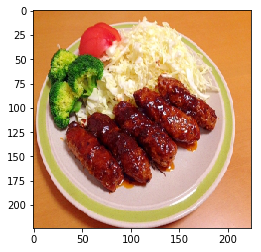

[ 61   3  81  15 226  13   0   0   0   0   0   0   0   0   0   0]
img 207: ['こんにゃく', 'みりん', 'オイスターソース', '塩', '料理酒', '生姜', '砂糖', '醤油', '鰯']
true : ['ナス', 'ハム', '片栗粉', '玉ねぎ', '砂糖', '紹興酒']
IoU: 0.07142857142857142


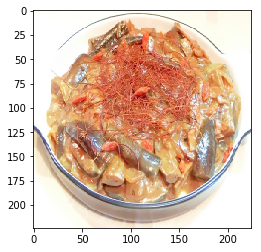

[129  29   2   0   0   0   0   0   0   0   0   0   0   0   0   0]
img 208: ['サラダ油', '塩コショウ', '揚げ油', '片栗粉', '生姜', '醤油', '鶏肉']
true : ['なんこつ', '塩', '小麦粉']
IoU: 0.0


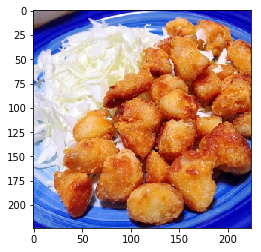

[  4 110   7   0   0   0   0   0   0   0   0   0   0   0   0   0]
img 209: ['だしの素', 'にんじん', 'ねぎ', 'みりん', '塩', '大根', '日本酒', '玉ねぎ', '生姜', '醤油']
true : ['エリンギ', 'オリーブオイル', 'ニンニク']
IoU: 0.0


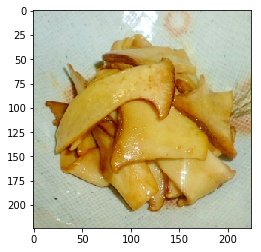

[ 28  45 146   0   0   0   0   0   0   0   0   0   0   0   0   0]
img 210: ['じゃがいも', 'にんじん', 'サラダ油', '塩', '塩コショウ', '落花生', '醤油', '黒胡椒']
true : ['キュウリ', 'クレイジーソルト', 'ベーコン']
IoU: 0.0


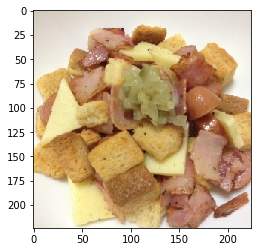

[16 68 73  0  0  0  0  0  0  0  0  0  0  0  0  0]
img 211: ['はんぺん', 'チーズ', '塩', '大根', '砂糖', '醤油']
true : ['クリームチーズ', 'サラダ油', '餃子の皮']
IoU: 0.0


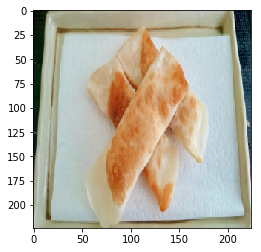

[ 51 122  56  66  14 187   0   0   0   0   0   0   0   0   0   0]
img 212: ['サラダ油', 'ズッキーニ', 'レンコン', '塩', '塩コショウ', '片栗粉', '砂糖', '鰹節', '麺つゆ']
true : ['ちくわ', 'コチュジャン', 'マヨネーズ', '一味唐辛子', '七味唐辛子', '魚肉ソーセージ']
IoU: 0.0


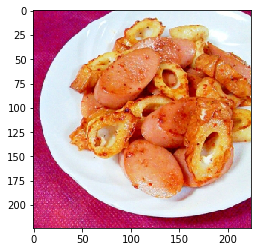

[ 43 112  32  14   0   0   0   0   0   0   0   0   0   0   0   0]
img 213: ['とろけるチーズ', 'サラダ油', '塩', '牛乳', '醤油']
true : ['オリーブ油', 'ツナ', 'マヨネーズ', '麺つゆ']
IoU: 0.0


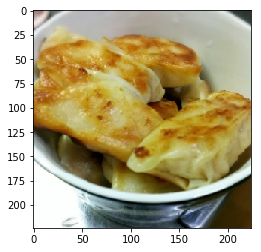

[27  3 58 83  1  0  0  0  0  0  0  0  0  0  0  0]
img 214: ['じゃがいも', 'アンチョビ', 'オリーブオイル', 'ソース', 'トマト', 'ニンニク', 'バター', '塩', '塩コショウ', '玉ねぎ', '醤油', '鶏肉']
true : ['唐辛子', '大根', '白ごま', '砂糖', '醤油']
IoU: 0.0625


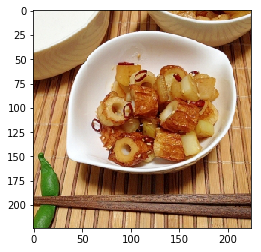

[165   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0]
img 215: ['塩']
true : ['']
IoU: 0.0


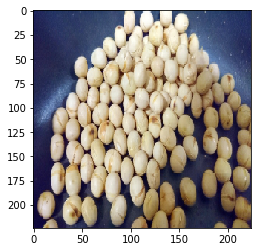

[ 44  78   1 245  14   0   0   0   0   0   0   0   0   0   0   0]
img 216: ['こしょう', 'みりん', 'オリーブオイル', 'オリーブ油', 'チーズ', 'パン粉', 'ブロッコリー', '塩', '大根', '玉ねぎ', '砂糖', '粒マスタード', '醤油', '青じそ', '鮭']
true : ['さつま揚げ', 'わさび', 'ブロッコリー', 'マヨネーズ', '醤油']
IoU: 0.1111111111111111


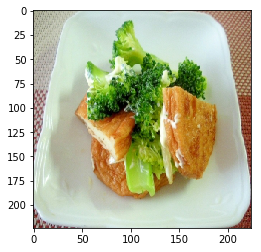

[166 139 210  14   0   0   0   0   0   0   0   0   0   0   0   0]
img 217: ['ねぎ', 'みりん', 'ポン酢', 'マヨネーズ', '塩', '塩コショウ', '大葉', '片栗粉', '玉ねぎ', '醤油']
true : ['しそ', 'はんぺん', 'マヨネーズ', '明太子']
IoU: 0.07692307692307693


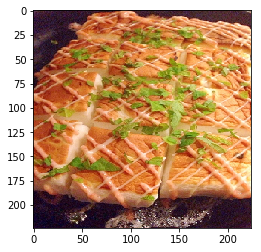

[ 5  1  3 60  0  0  0  0  0  0  0  0  0  0  0  0]
img 218: ['こんにゃく', 'みりん', 'ラー油', '一味唐辛子', '三温糖', '生姜', '醤油', '麺つゆ']
true : ['こんにゃく', 'ゴマ油', '砂糖', '醤油']
IoU: 0.2


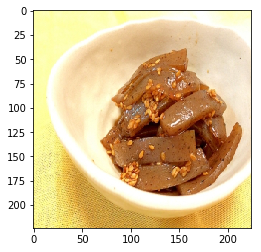

[  1   5   4 231  30   0   0   0   0   0   0   0   0   0   0   0]
img 219: ['みりん', 'ゴマ', '砂糖', '砂肝', '醤油']
true : ['ゴマ', 'ゴマ油', 'チリソース', 'ニンニク', '醤油']
IoU: 0.25


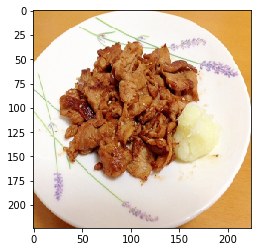

[ 3  1 10 67 99  0  0  0  0  0  0  0  0  0  0  0]
img 220: ['だしの素', 'ねぎ', 'はちみつ', 'みりん', 'ウスターソース', 'ケチャップ', 'ナツメグ', 'ニンニク', '卵', '塩コショウ', '片栗粉', '生姜', '砂糖', '醤油', '黒胡椒']
true : ['ホタテ', '料理酒', '生姜', '砂糖', '醤油']
IoU: 0.17647058823529413


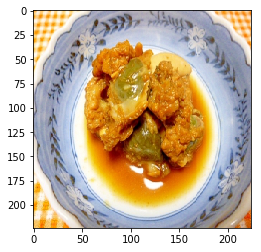

[ 18 157   2  12  96   7  29   0   0   0   0   0   0   0   0   0]
img 221: ['こしょう', 'みりん', 'サラダ油', '卵', '塩', '塩コショウ', '片栗粉', '生姜', '砂糖', '粉チーズ', '醤油', '里芋', '長芋']
true : ['オリーブオイル', 'ローズマリー', '塩', '小麦粉', '酢', '長芋', '黒胡椒']
IoU: 0.1111111111111111


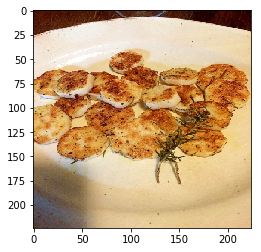

[ 61   7 116   1   0   0   0   0   0   0   0   0   0   0   0   0]
img 222: ['ゴマ油', 'バター', 'マグロ', 'レモン', '塩', '醤油', '鷹の爪', '黒胡椒']
true : ['オリーブオイル', 'ガーリックパウダー', 'ナス', '醤油']
IoU: 0.09090909090909091


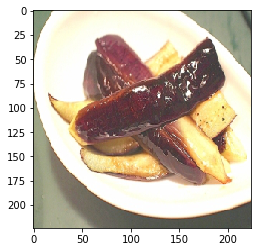

[ 16   3 149   8   1 169   0   0   0   0   0   0   0   0   0   0]
img 223: ['だしの素', 'にんじん', 'ねぎ', 'みりん', '塩', '大根', '砂糖', '茗荷', '酢', '醤油', '鷹の爪']
true : ['ねぎ', 'わかめ', 'サラダ油', 'ナンプラー', '砂糖', '醤油']
IoU: 0.21428571428571427


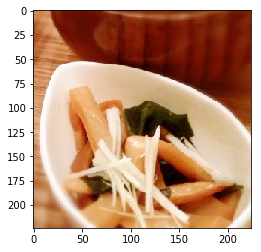

[54 37  6 46 11 13  7 62  0  0  0  0  0  0  0  0]
img 224: ['ねぎ', 'みりん', '塩', '揚げ油', '豆腐', '醤油']
true : ['しめじ', 'オリーブオイル', '卵', '塩コショウ', '牛乳', '玉ねぎ', '粉チーズ', '豆腐']
IoU: 0.07692307692307693


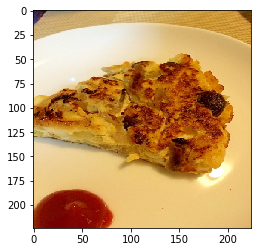

[32 56 46 41 66  0  0  0  0  0  0  0  0  0  0  0]
img 225: ['みりん', 'キュウリ', 'ゴマ油', 'サラダ油', '砂糖', '酢', '醤油']
true : ['しめじ', 'ちくわ', 'ピーマン', '一味唐辛子', '麺つゆ']
IoU: 0.0


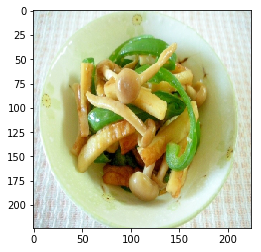

[  3  51  56   6  17   1   5   9 103   0   0   0   0   0   0   0]
img 226: ['みりん', 'ゴマ油', 'サラダ油', 'レンコン', '大根', '砂糖', '豚肉', '酢', '醤油']
true : ['だしの素', 'ちくわ', 'みりん', 'ゴマ油', '七味唐辛子', '塩コショウ', '牛肉', '砂糖', '醤油']
IoU: 0.2857142857142857


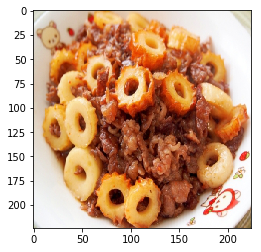

[105  39   1  41  15  59   0   0   0   0   0   0   0   0   0   0]
img 227: ['こしょう', 'ゴマ油', 'サラダ油', 'ナンプラー', 'ニンニク', '塩', '日本酒', '片栗粉']
true : ['オイスターソース', 'キャノーラ油', 'ピーマン', '片栗粉', '豚肉', '醤油']
IoU: 0.07692307692307693


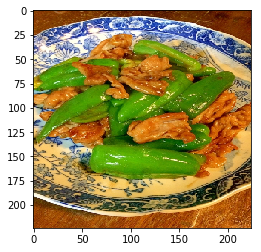

[102   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0]
img 228: ['イカ', 'エビ', 'オリーブオイル', 'ゴマ油', 'バター', 'パスタ', 'マヨネーズ', '塩コショウ', '日本酒', '油揚げ', '粉チーズ', '鰹節']
true : ['ラー油']
IoU: 0.0


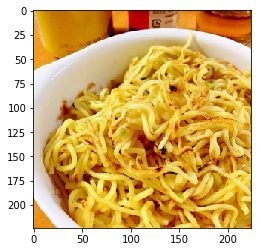

[105   3  25 260  18  56  17   8   1  84   0   0   0   0   0   0]
img 229: ['ねぎ', 'ゴマ油', '一味唐辛子', '卵', '厚揚げ', '生姜', '醤油']
true : ['おから', 'ごぼう', 'だしの素', 'ちくわ', 'にんじん', 'ねぎ', 'キャノーラ油', '砂糖', '酢', '醤油']
IoU: 0.13333333333333333


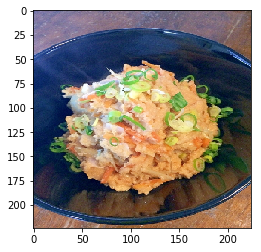

[32  8 83  0  0  0  0  0  0  0  0  0  0  0  0  0]
img 230: ['しめじ', 'ねぎ', 'もやし', 'カイワレ', 'ガーリックソルト', 'ゴマ油', 'マヨネーズ', '酢', '醤油', '鶏皮']
true : ['ねぎ', '唐辛子', '麺つゆ']
IoU: 0.08333333333333333


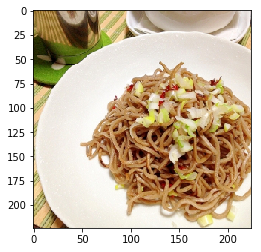

[ 62  72 249   0   0   0   0   0   0   0   0   0   0   0   0   0]
img 231: ['こしょう', 'じゃがいも', 'オリーブオイル', 'ガーリックパウダー', 'ベーコン', '塩', '粒マスタード', '鶏肉', '黒胡椒']
true : ['ガラムマサラ', 'コンソメ', '粉チーズ']
IoU: 0.0


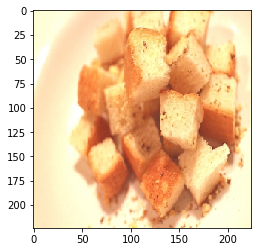

[27 67  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
img 232: ['だしの素', 'にんじん', 'ねぎ', 'みりん', 'もやし', 'ゴマ油', 'ニンニク', '塩コショウ', '片栗粉', '醤油', '鶏肉']
true : ['大根', '料理酒']
IoU: 0.0


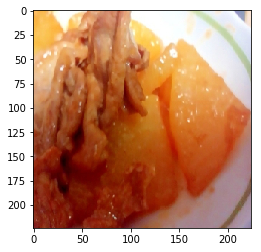

[32 37  8 31 86 67 60  0  0  0  0  0  0  0  0  0]
img 233: ['ゴマ油', 'ポン酢', '塩昆布', '柚子', '玉ねぎ', '白菜']
true : ['こんにゃく', 'ねぎ', 'ポン酢', '料理酒', '白菜', '豆腐', '麺つゆ']
IoU: 0.18181818181818182


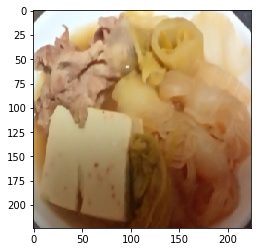

[116  26  15   6   0   0   0   0   0   0   0   0   0   0   0   0]
img 234: ['みりん', '味噌', '大根', '焼肉のたれ', '砂糖', '豚肉', '醤油', '鮭']
true : ['こしょう', 'ガーリックパウダー', '塩コショウ', '片栗粉']
IoU: 0.0


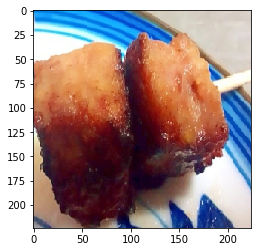

[35  3 17  1 13  9  7  0  0  0  0  0  0  0  0  0]
img 235: ['えのき', 'エビ', '塩', '醤油']
true : ['だしの素', 'みりん', 'オリーブオイル', 'トマト', '玉ねぎ', '砂糖', '醤油']
IoU: 0.1


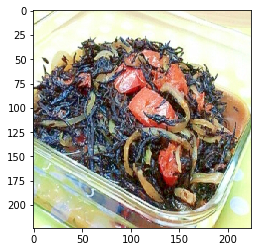

[ 6  5 46 59  0  0  0  0  0  0  0  0  0  0  0  0]
img 236: ['かぼちゃ', 'ゴマ油', 'シイタケ', '塩', '醤油']
true : ['しめじ', 'オイスターソース', 'ゴマ油', '塩コショウ']
IoU: 0.125


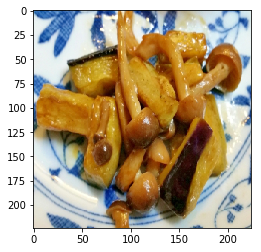

[158 105  37   6  15   8  11  23  19   0   0   0   0   0   0   0]
img 237: ['ゴマ油', 'チーズ', '醤油']
true : ['ねぎ', 'キャノーラ油', 'チーズ', '卵', '味噌', '塩コショウ', '片栗粉', '豆腐', '鶏ひき肉']
IoU: 0.09090909090909091


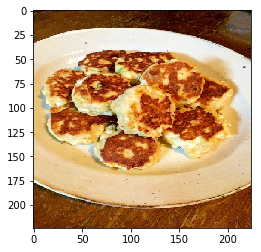

[35  3  1 57  2  5 11  0  0  0  0  0  0  0  0  0]
img 238: ['ねぎ', '塩', '玉ねぎ', '粉チーズ', '醤油', '黒胡椒']
true : ['ゴマ油', 'トマト', '卵', '塩', '砂糖', '醤油', '鶏ガラスープの素']
IoU: 0.18181818181818182


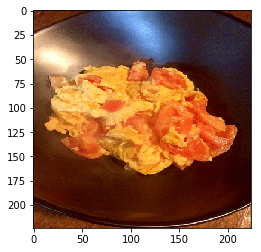

[32 17 66  5 60  9 67  0  0  0  0  0  0  0  0  0]
img 239: ['ゴマ油', 'チーズ', 'マグロ', '塩', '大根', '砂糖', '粉チーズ', '鮭', '麺つゆ']
true : ['こんにゃく', 'だしの素', 'みりん', 'ゴマ油', '一味唐辛子', '料理酒', '麺つゆ']
IoU: 0.14285714285714285


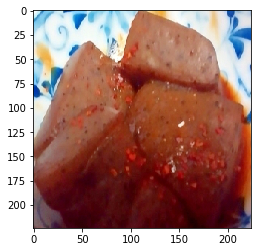

[38 39  6 33 19  0  0  0  0  0  0  0  0  0  0  0]
img 240: ['こしょう', 'じゃがいも', 'イカ', 'エビ', 'エリンギ', 'オリーブオイル', 'タコ', 'トマト', 'ニンニク', 'ピーマン', 'レモン', '塩', '塩コショウ']
true : ['じゃがいも', 'チーズ', '塩コショウ', '大葉', '豚肉']
IoU: 0.125


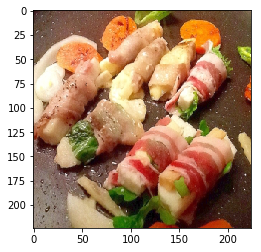

[221  25   6   8  59  15  86   5  67 102   0   0   0   0   0   0]
img 241: ['かぶ', 'だしの素', 'にんじん', 'アスパラ', 'キャベツ', 'キュウリ', '卵', '塩', '塩コショウ', '大根', '片栗粉', '玉ねぎ']
true : ['にんじん', 'ねぎ', 'オイスターソース', 'ゴマ油', 'ザーサイ', 'ラー油', '塩コショウ', '料理酒', '片栗粉', '白菜']
IoU: 0.15789473684210525


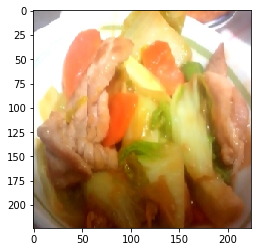

[  6  46   5 136  13   4   0   0   0   0   0   0   0   0   0   0]
img 242: ['ちくわ', 'ねぎ', 'みりん', 'ゴマ油', 'サラダ油', 'ザーサイ', '砂糖', '醤油']
true : ['しめじ', 'ゴマ油', 'ニンニク', '味の素', '塩コショウ', '玉ねぎ']
IoU: 0.07692307692307693


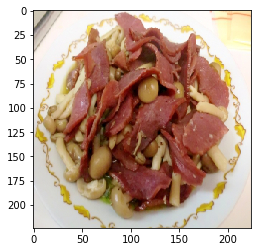

[105 172   2   0   0   0   0   0   0   0   0   0   0   0   0   0]
img 243: ['ねぎ', 'チーズ', '塩', '塩コショウ', '玉ねぎ']
true : ['キャノーラ油', '塩', '強力粉']
IoU: 0.14285714285714285


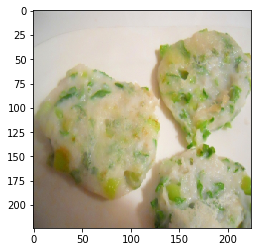

[ 34 109  80   0   0   0   0   0   0   0   0   0   0   0   0   0]
img 244: ['こしょう', 'ねぎ', 'みりん', 'サラダ油', 'レモン', '卵', '塩', '揚げ油', '片栗粉', '生姜', '醤油', '青海苔', '鶏肉', '黒胡椒']
true : ['揚げ油', '薄力粉', '青海苔']
IoU: 0.13333333333333333


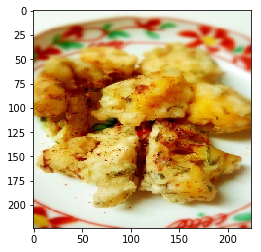

[187  11  32   0   0   0   0   0   0   0   0   0   0   0   0   0]
img 245: ['じゃがいも', 'オリーブオイル', 'コンソメ', 'サラダ油', 'チーズ', 'トマト', 'マヨネーズ', '卵', '塩', '塩コショウ', '小麦粉', '揚げ油', '青海苔']
true : ['卵', '魚肉ソーセージ', '麺つゆ']
IoU: 0.06666666666666667


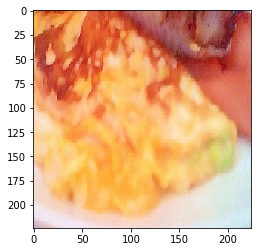

[ 18   4  49 157   2  84  12  76   7   0   0   0   0   0   0   0]
img 246: ['オリーブオイル', 'サラダ油', 'バター', '醤油']
true : ['ごぼう', 'オリーブオイル', 'ニンニク', 'レンコン', 'ローズマリー', '塩', '酢', '鷹の爪', '黒胡椒']
IoU: 0.08333333333333333


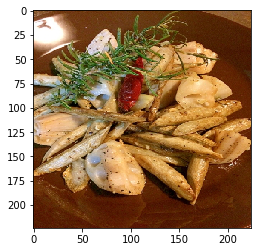

[ 67 163   2   0   0   0   0   0   0   0   0   0   0   0   0   0]
img 247: ['サラダ油', '焼肉のたれ', '片栗粉', '砂糖', '醤油', '鮭', '鶏肉']
true : ['塩', '料理酒', '柚子こしょう']
IoU: 0.0


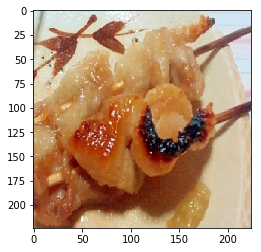

[25 33  1  5  9 30  0  0  0  0  0  0  0  0  0  0]
img 248: ['だしの素', 'にんじん', 'ねぎ', 'もやし', 'キャベツ', 'ゴマ油', 'ニンニク', '塩', '玉ねぎ', '醤油', '鰹節', '黒胡椒']
true : ['じゃがいも', 'にんじん', 'みりん', 'ゴマ', 'ゴマ油', '醤油']
IoU: 0.2


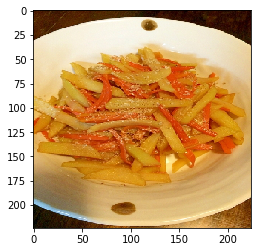

[ 35  42  54   1  20  69  11 186  62   0   0   0   0   0   0   0]
img 249: ['とろけるチーズ', 'ねぎ', 'ゴマ油', 'ニンニク', '片栗粉', '納豆', '醤油']
true : ['はちみつ', 'トマト', 'バター', 'パセリ', '卵', '牛乳', '粉チーズ', '舞茸', '醤油']
IoU: 0.06666666666666667


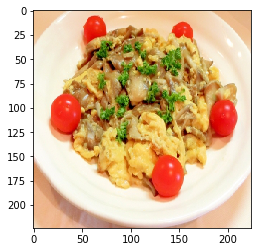

[ 25  15   8  14 220  29   0   0   0   0   0   0   0   0   0   0]
img 250: ['はんぺん', 'チーズ', 'マヨネーズ', '卵', '味噌', '牛乳', '生クリーム']
true : ['にんじん', 'ねぎ', 'マヨネーズ', '小麦粉', '片栗粉', '紅しょうが']
IoU: 0.08333333333333333


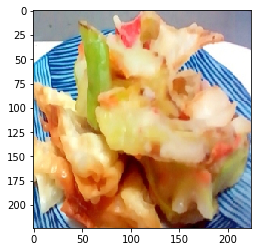

[105  12  39   2   0   0   0   0   0   0   0   0   0   0   0   0]
img 251: ['オリーブ油', 'チーズ', '塩', '揚げ油', '鰯', '鶏肉']
true : ['キャノーラ油', '塩', '豚肉', '黒胡椒']
IoU: 0.1111111111111111


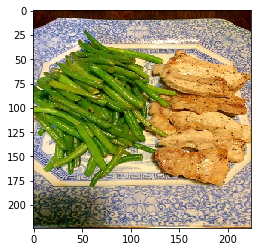

[236   1   2   5  82 128   0   0   0   0   0   0   0   0   0   0]
img 252: ['塩', '生姜', '醤油', '鰹']
true : ['ゴマ油', '塩', '小松菜', '縮緬雑魚', '豆板醤', '醤油']
IoU: 0.25


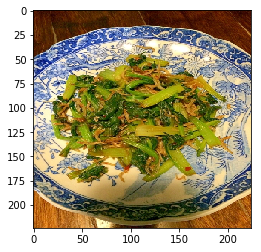

[ 42 139  72 109  70  62  34   0   0   0   0   0   0   0   0   0]
img 253: ['ごぼう', '塩', '揚げ油', '片栗粉', '醤油', '鶏肉', '黒胡椒']
true : ['はんぺん', 'コンソメ', 'パセリ', 'パン粉', '揚げ油', '粉チーズ', '薄力粉']
IoU: 0.07692307692307693


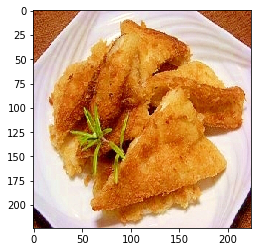

[  4  49   6   1  43 174 195  76   0   0   0   0   0   0   0   0]
img 254: ['ちくわ', 'ねぎ', 'オリーブオイル', 'キムチ', 'ゴマ油', 'ニラ', 'ラー油', '塩', '小麦粉', '砂糖', '醤油', '鷹の爪', '麺つゆ']
true : ['アスパラ', 'アンチョビ', 'オリーブ油', 'ニンニク', 'レンコン', '塩コショウ', '醤油', '鷹の爪']
IoU: 0.10526315789473684


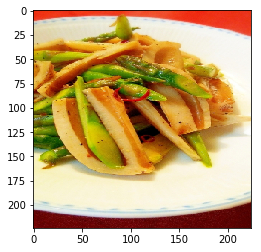

[  5 111   0   0   0   0   0   0   0   0   0   0   0   0   0   0]
img 255: ['ねぎ', 'ゴマ油', 'サラダ油', '卵', '塩', '塩麹', '砂糖', '醤油']
true : ['キムチ', 'ゴマ油']
IoU: 0.1111111111111111


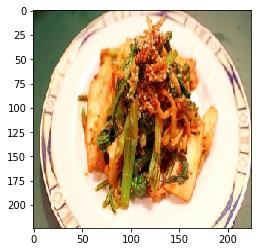

[  2 135  14  70  62   0   0   0   0   0   0   0   0   0   0   0]
img 256: ['ニンニク', '玉ねぎ', '生姜', '醤油', '黒胡椒']
true : ['パン粉', 'マヨネーズ', '塩', '粉チーズ', '鯵']
IoU: 0.0


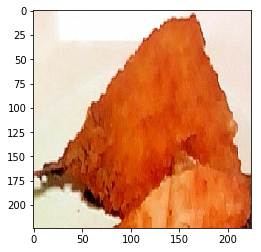

[27 58 18  1  2  5  0  0  0  0  0  0  0  0  0  0]
img 257: ['チーズ', 'パン粉', '卵', '塩', '塩コショウ', '小麦粉', '揚げ油', '粉チーズ', '醤油', '青海苔', '鶏肉']
true : ['ゴマ油', '塩', '大根', '白ごま', '酢', '醤油']
IoU: 0.13333333333333333


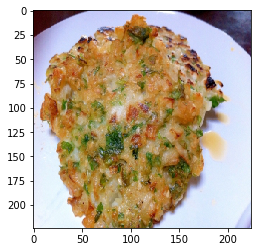

[ 3 25  1 41  2  5 13  4 30  0  0  0  0  0  0  0]
img 258: ['こしょう', 'じゃがいも', 'みりん', 'オリーブオイル', 'チーズ', 'ベーコン', '塩', '塩コショウ', '小麦粉', '白菜', '鰹節']
true : ['にんじん', 'ゴマ', 'ゴマ油', 'ニンニク', 'ピーマン', '塩', '玉ねぎ', '砂糖', '醤油']
IoU: 0.05263157894736842


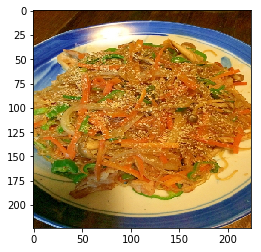

[ 27   8  36 215  29   0   0   0   0   0   0   0   0   0   0   0]
img 259: ['だしの素', 'オイスターソース', 'マヨネーズ', '卵', '塩', '醤油']
true : ['とろけるチーズ', 'ねぎ', 'カニカマ', '大根', '小麦粉']
IoU: 0.0


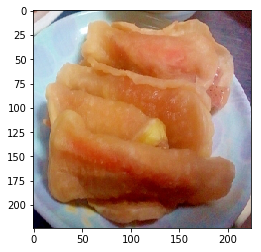

[ 27 120   1  15  14  29   0   0   0   0   0   0   0   0   0   0]
img 260: ['オリーブオイル', 'サラダ油', 'マヨネーズ', '卵', '塩コショウ', '片栗粉', '鶏肉']
true : ['ウインナー', 'マヨネーズ', '大根', '小麦粉', '片栗粉', '醤油']
IoU: 0.18181818181818182


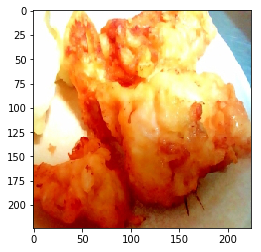

[22 46  6 55 20 13  0  0  0  0  0  0  0  0  0  0]
img 261: ['しめじ', 'ねぎ', 'ゴマ油', '河豚', '生姜', '醤油']
true : ['しめじ', 'バター', 'レモン', '塩コショウ', '玉ねぎ', '白ワイン']
IoU: 0.09090909090909091


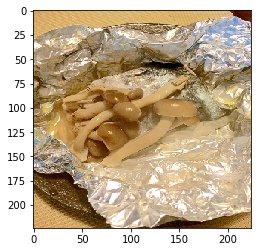

[ 6  1 20  9 53  0  0  0  0  0  0  0  0  0  0  0]
img 262: ['ごぼう', 'だしの素', 'イカ', 'サラダ油', 'マヨネーズ', '塩', '塩コショウ', '山芋', '海苔', '酢', '醤油']
true : ['みりん', 'イカ', 'バター', '塩コショウ', '醤油']
IoU: 0.23076923076923078


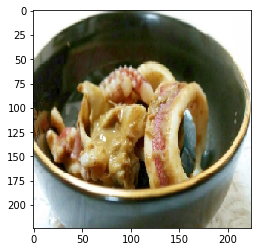

[210  11 159  14   0   0   0   0   0   0   0   0   0   0   0   0]
img 263: ['だしの素', 'みりん', 'マヨネーズ', '卵', '塩', '片栗粉', '砂糖']
true : ['セロリ', 'マヨネーズ', '卵', '明太子']
IoU: 0.2222222222222222


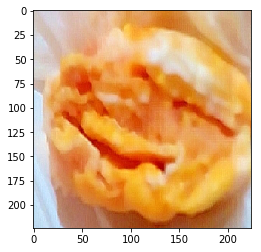

[9 3 1 0 0 0 0 0 0 0 0 0 0 0 0 0]
img 264: ['こんにゃく', 'たらこ', 'だしの素', 'みりん', 'ゴマ油', '一味唐辛子', '大根', '砂糖', '醤油', '鰹節', '麺つゆ']
true : ['みりん', '砂糖', '醤油']
IoU: 0.2727272727272727


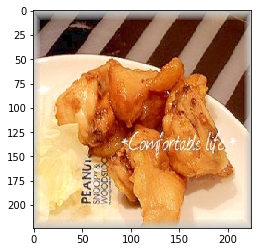

[ 7  6 20 18  0  0  0  0  0  0  0  0  0  0  0  0]
img 265: ['コーン', 'サラダ油', '塩', '小麦粉', '揚げ油', '片栗粉', '砂糖', '粉チーズ', '醤油', '黒胡椒']
true : ['オリーブオイル', 'バター', '塩コショウ', '酢']
IoU: 0.0


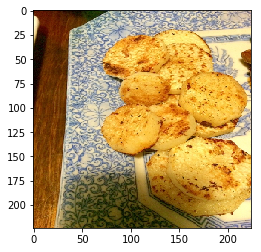

[ 50 143  56  17  24   1   2  15  11   9 151   0   0   0   0   0]
img 266: ['ご飯', 'だしの素', 'みりん', 'ソース', '卵', '味噌', '大根', '昆布', '油揚げ', '玉ねぎ', '砂糖', '醤油']
true : ['だしの素', 'だし醤油', 'ちくわ', 'みりん', 'エビ', '卵', '塩', '片栗粉', '醤油', '鰹', '鶏肉']
IoU: 0.21052631578947367


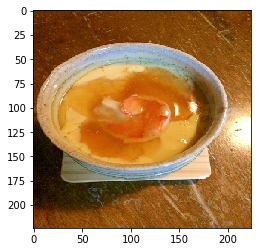

[  1  59 148  82 102   0   0   0   0   0   0   0   0   0   0   0]
img 267: ['すだち', 'みりん', 'サラダ油', '味噌', '唐揚げ粉', '生姜', '醤油', '鶏肉']
true : ['オイスターソース', 'ソーセージ', 'ラー油', '豆板醤', '醤油']
IoU: 0.08333333333333333


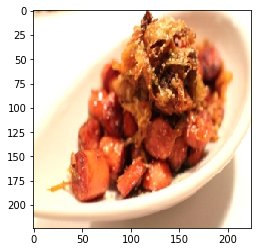

[5 8 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
img 268: ['アスパラ', 'オリーブオイル', 'キュウリ', 'チーズ', 'レモン', '塩', '塩コショウ', '大葉', '生ハム']
true : ['ねぎ', 'ゴマ油']
IoU: 0.0


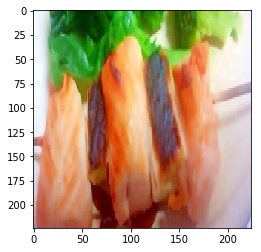

[105  40  48   6  41   1  80 162  13   0   0   0   0   0   0   0]
img 269: ['チーズ', '塩', '生姜', '醤油', '鰹節']
true : ['ウスターソース', 'キャノーラ油', 'キャベツ', 'ピーマン', '塩コショウ', '玉ねぎ', '醤油', '青海苔', '鰹節']
IoU: 0.16666666666666666


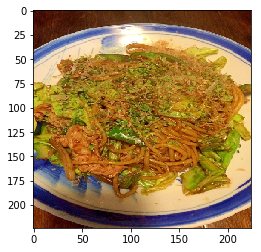

[105   3  25  37  17   1   2  11   9 128   0   0   0   0   0   0]
img 270: ['ねぎ', 'ゴマ油', '卵', '塩', '砂肝', '醤油', '黒胡椒']
true : ['だしの素', 'にんじん', 'みりん', 'キャノーラ油', '卵', '塩', '小松菜', '砂糖', '豆腐', '醤油']
IoU: 0.21428571428571427


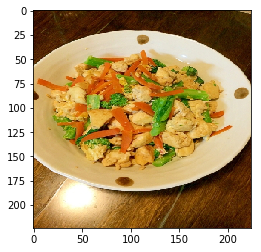

[ 16  42  26 148   2  13   0   0   0   0   0   0   0   0   0   0]
img 271: ['こしょう', 'ねぎ', 'エリンギ', 'オリーブオイル', 'ガーリックパウダー', 'ニンニク', 'レモン', '塩', '塩コショウ']
true : ['こしょう', 'サラダ油', 'ソーセージ', 'パセリ', '塩', '玉ねぎ']
IoU: 0.15384615384615385


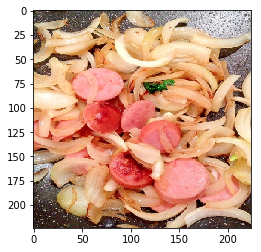

[  7  33 154   0   0   0   0   0   0   0   0   0   0   0   0   0]
img 272: ['じゃがいも', 'バター', 'レモン', '塩', '片栗粉', '黒胡椒']
true : ['じゃがいも', 'オリーブオイル', 'ジェノベーゼソース']
IoU: 0.125


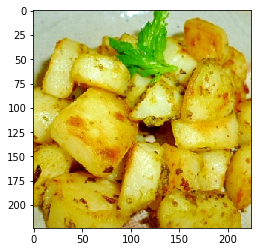

[ 6 55 24 20  4  7 29  0  0  0  0  0  0  0  0  0]
img 273: ['だしの素', 'ねぎ', 'みりん', 'ゴマ油', '塩', '油揚げ', '粉チーズ', '醤油', '長芋', '鰹節', '黒胡椒']
true : ['オリーブオイル', 'ニンニク', 'バター', '塩コショウ', '小麦粉', '白ワイン', '鶏肉']
IoU: 0.0


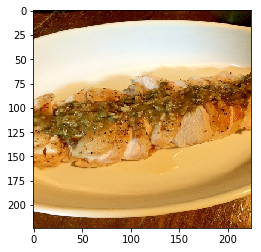

[26 43 78  0  0  0  0  0  0  0  0  0  0  0  0  0]
img 274: ['えんどう豆', 'アラ', 'サラダ油', 'ヨーグルト', '卵', '塩', '塩コショウ', '片栗粉', '豚肉', '鶏むね肉', '黒胡椒']
true : ['こしょう', 'オリーブ油', 'ブロッコリー']
IoU: 0.0


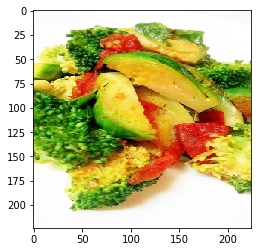

[ 9  3  1 30  0  0  0  0  0  0  0  0  0  0  0  0]
img 275: ['こんにゃく', 'ねぎ', 'みりん', 'ゴマ', 'ゴマ油', 'ムツ', '砂糖', '砂肝', '醤油', '黒胡椒']
true : ['みりん', 'ゴマ', '砂糖', '醤油']
IoU: 0.4


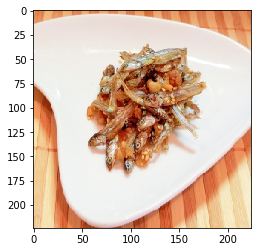

[ 6 46 70 45 13  7  0  0  0  0  0  0  0  0  0  0]
img 276: ['じゃがいも', 'みりん', 'オリーブオイル', 'マヨネーズ', '厚揚げ', '塩', '砂糖', '粉チーズ', '醤油']
true : ['しめじ', 'オリーブオイル', 'パン粉', 'ベーコン', '塩コショウ', '玉ねぎ']
IoU: 0.07142857142857142


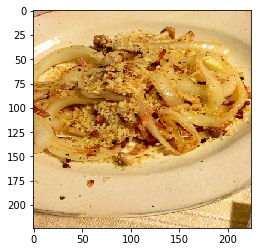

[ 10 114  24   2   0   0   0   0   0   0   0   0   0   0   0   0]
img 277: ['キュウリ', 'ニンニク', 'パン粉', '卵', '塩', '塩コショウ', '大根', '小麦粉', '揚げ油', '片栗粉', '玉ねぎ', '鶏肉']
true : ['塩', '山椒', '生姜', '鶏肉']
IoU: 0.14285714285714285


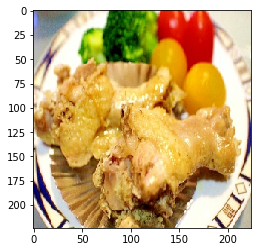

[ 35 126  52  26  15  77   0   0   0   0   0   0   0   0   0   0]
img 278: ['キュウリ', 'トマト', 'マヨネーズ', '塩', '豆腐', '醤油', '鶏肉']
true : ['かぼちゃ', 'こしょう', 'ケチャップ', 'トマト', 'レタス', '片栗粉']
IoU: 0.08333333333333333


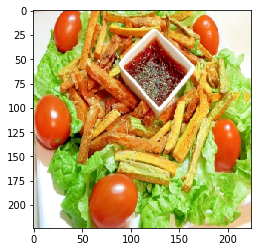

[139  45  96  70  29   0   0   0   0   0   0   0   0   0   0   0]
img 279: ['だしの素', 'ニンニク', '塩', '塩コショウ', '天ぷら粉', '小麦粉', '生姜', '砂糖', '豆腐', '豚肉']
true : ['はんぺん', 'パン粉', 'ベーコン', '小麦粉', '長芋']
IoU: 0.07142857142857142


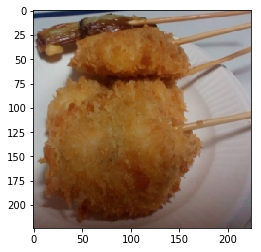

[ 78  52 148  68 173   0   0   0   0   0   0   0   0   0   0   0]
img 280: ['しそ', 'ねぎ', 'オリーブオイル', 'ゴマ', 'チーズ', 'マヨネーズ', '刺身', '厚揚げ', '塩', '白ワイン', '醤油', '鶏肉']
true : ['ケチャップ', 'ソーセージ', 'ブロッコリー', 'マスタード', '餃子の皮']
IoU: 0.0


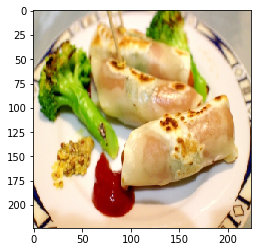

[ 38 105   6 119  29   0   0   0   0   0   0   0   0   0   0   0]
img 281: ['じゃがいも', 'マヨネーズ', '塩', '玉ねぎ', '鶏肉', '黒胡椒']
true : ['キャノーラ油', '塩コショウ', '大葉', '小麦粉', '梅干し']
IoU: 0.0


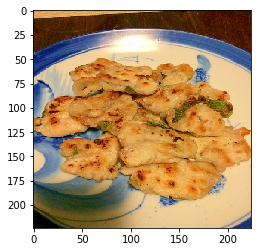

[16 89 32  1  8  5 10 67  9 29  0  0  0  0  0  0]
img 282: ['こしょう', 'だしの素', 'ゴマ油', 'ズッキーニ', 'ニンニク', 'パセリ', 'マヨネーズ', 'レモン', '塩', '粉チーズ', '粒マスタード', '醤油', '鮭']
true : ['ねぎ', 'みりん', 'ゴマ油', 'サラダ油', 'マグロ', '小麦粉', '料理酒', '生姜', '醤油', '麺つゆ']
IoU: 0.09523809523809523


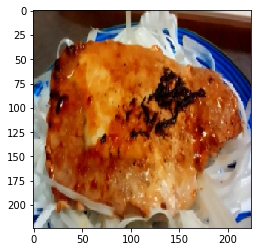

[21 10  1  0  0  0  0  0  0  0  0  0  0  0  0  0]
img 283: ['みりん', '日本酒', '生姜', '砂糖', '醤油', '鯛']
true : ['日本酒', '生姜', '醤油']
IoU: 0.5


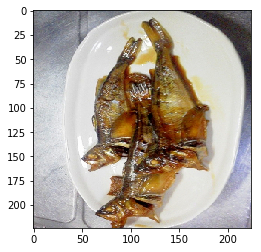

[ 54 109   7  73  19   0   0   0   0   0   0   0   0   0   0   0]
img 284: ['こしょう', 'ウインナー', 'オリーブオイル', 'チーズ', 'ニンニク', 'バター', 'レモン', '塩', '塩コショウ', '小麦粉', '揚げ油', '玉ねぎ']
true : ['オリーブオイル', 'クリームチーズ', 'チーズ', '牛乳', '薄力粉']
IoU: 0.13333333333333333


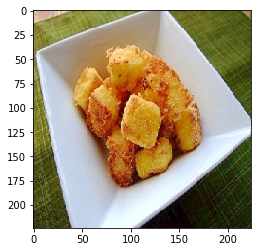

[ 65   8 117  10  67   9   0   0   0   0   0   0   0   0   0   0]
img 285: ['じゃがいも', 'にんじん', 'オリーブオイル', 'キュウリ', 'ニンニク', 'バター', 'パセリ', 'ピーマン', '塩コショウ', '大根', '小麦粉', '玉ねぎ', '砂糖']
true : ['ねぎ', 'みりん', '料理酒', '油揚げ', '焼肉のたれ', '生姜']
IoU: 0.0


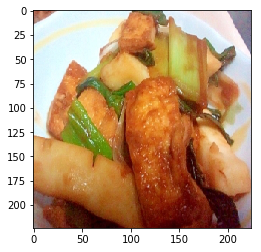

[158  15   5  76 111   0   0   0   0   0   0   0   0   0   0   0]
img 286: ['みりん', 'ゴマ油', 'パン粉', '塩', '塩コショウ', '揚げ油', '醤油', '鰹節', '黒胡椒']
true : ['キムチ', 'ゴマ油', 'レンコン', '片栗粉', '鶏ひき肉']
IoU: 0.07692307692307693


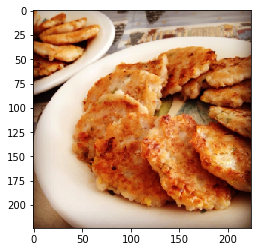

[27 32 71 60  9 67  0  0  0  0  0  0  0  0  0  0]
img 287: ['だしの素', 'にんじん', 'みりん', 'オリーブオイル', 'コチュジャン', '塩コショウ', '玉ねぎ', '醤油']
true : ['こんにゃく', 'みりん', '厚揚げ', '大根', '料理酒', '麺つゆ']
IoU: 0.07692307692307693


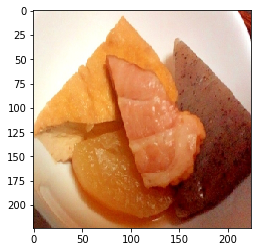

[139 111 178  36   0   0   0   0   0   0   0   0   0   0   0   0]
img 288: ['こしょう', 'コンソメ', 'チーズ', 'ニンニク', 'ブロッコリー', 'マヨネーズ', '塩コショウ', '天ぷら粉', '牛乳']
true : ['とろけるチーズ', 'はんぺん', 'キムチ', '春巻きの皮']
IoU: 0.0


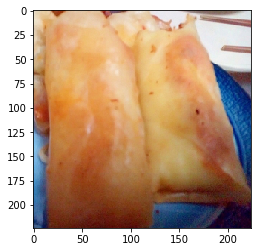

[156  15  10  82  14   4   0   0   0   0   0   0   0   0   0   0]
img 289: ['じゃがいも', 'ゴマ油', '塩コショウ', '黒胡椒']
true : ['カレー粉', 'ニンニク', 'マヨネーズ', '片栗粉', '生姜', '豆板醤']
IoU: 0.0


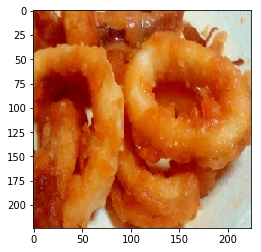

[25 26  1  5 76  0  0  0  0  0  0  0  0  0  0  0]
img 290: ['わさび', 'オリーブ油', 'ニンニク', '卵', '生姜', '醤油']
true : ['こしょう', 'にんじん', 'ゴマ油', 'レンコン', '醤油']
IoU: 0.1


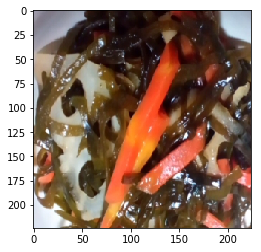

[72 49  1 84  9 67 60  0  0  0  0  0  0  0  0  0]
img 291: ['だしの素', 'にんじん', 'もやし', 'ゴマ油', 'ニンニク', '塩', '塩コショウ', '砂糖', '鶏ガラスープの素']
true : ['こんにゃく', 'ごぼう', 'みりん', 'コンソメ', '料理酒', '醤油', '鷹の爪']
IoU: 0.0


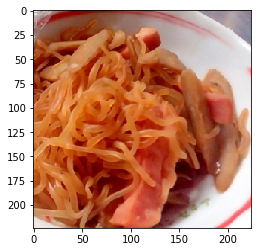

[ 3 32 25  4  6 24 20  1 10 13  9 67  0  0  0  0]
img 292: ['こんにゃく', 'みりん', 'コチュジャン', 'ゴマ油', 'マグロ', '塩コショウ', '醤油', '鰹節', '鶏肉', '麺つゆ']
true : ['にんじん', 'みりん', 'ニンニク', 'バター', '塩コショウ', '料理酒', '玉ねぎ', '生姜', '砂糖', '醤油', '鶏肉', '麺つゆ']
IoU: 0.29411764705882354


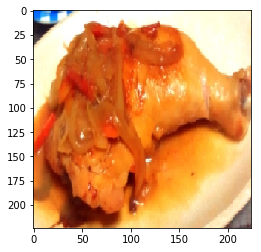

[105 143  46  15   2  11   0   0   0   0   0   0   0   0   0   0]
img 293: ['こんにゃく', 'にんじん', 'ねぎ', 'ニンニク', '卵', '味噌', '塩', '大根', '日本酒', '生姜', '砂糖', '醤油', '鰹節', '麺つゆ']
true : ['しめじ', 'だし醤油', 'キャノーラ油', '卵', '塩', '片栗粉']
IoU: 0.1111111111111111


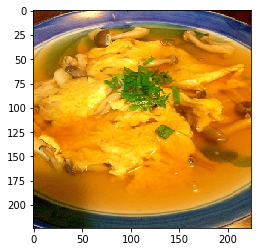

[120   8  68   5  10 111   0   0   0   0   0   0   0   0   0   0]
img 294: ['じゃがいも', 'とろけるチーズ', 'ニンニク', '塩コショウ', '生クリーム', '鯵']
true : ['ねぎ', 'ウインナー', 'キムチ', 'ゴマ油', '生姜', '餃子の皮']
IoU: 0.0


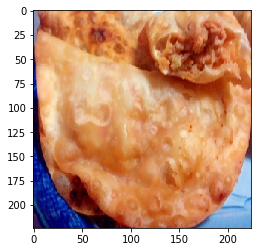

[105  40  48   6  41  80 162  11  13   0   0   0   0   0   0   0]
img 295: ['サラダ油', '卵', '塩', '塩コショウ', '揚げ油', '粉チーズ', '酒粕']
true : ['ウスターソース', 'キャノーラ油', 'キャベツ', 'ピーマン', '卵', '塩コショウ', '玉ねぎ', '青海苔', '鰹節']
IoU: 0.14285714285714285


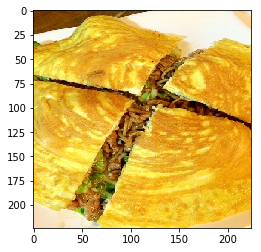

[ 40  48 141   5  11  14 111   0   0   0   0   0   0   0   0   0]
img 296: ['ねぎ', 'ピザ生地', 'マヨネーズ', '豚肉', '酒粕', '醤油']
true : ['キムチ', 'キャベツ', 'ゴマ油', 'ソース', 'マヨネーズ', '卵', '鰹節']
IoU: 0.08333333333333333


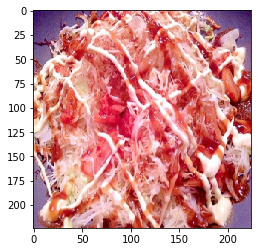

[ 25 142 186  41 110 177  13 187   0   0   0   0   0   0   0   0]
img 297: ['だしの素', 'みりん', 'キュウリ', 'ポン酢', 'レモン', '塩', '塩コショウ', '砂糖', '酢']
true : ['にんじん', 'エリンギ', 'パプリカ', 'ピーマン', '炒め用油', '玉ねぎ', '舞茸', '魚肉ソーセージ']
IoU: 0.0


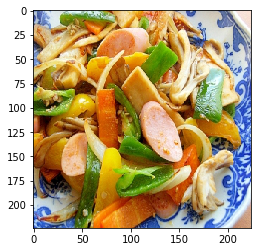

[  3  32  37  11  13   9  67 128   0   0   0   0   0   0   0   0]
img 298: ['こんにゃく', 'じゃがいも', 'ほうれん草', 'オリーブオイル', 'ゴマ油', 'バター', '塩', '塩コショウ', '大葉', '小ねぎ', '小松菜', '油揚げ', '生姜', '砂糖', '醤油', '麺つゆ']
true : ['みりん', '卵', '小松菜', '料理酒', '玉ねぎ', '砂糖', '豆腐', '麺つゆ']
IoU: 0.14285714285714285


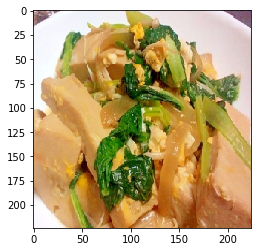

[105   3   1  15  41  59  13   0   0   0   0   0   0   0   0   0]
img 299: ['ナンプラー', 'ニラ', 'ニンニク', 'レモン', '塩', '塩コショウ', '豆板醤', '醤油']
true : ['オイスターソース', 'キャノーラ油', 'ピーマン', '片栗粉', '玉ねぎ', '砂糖', '醤油']
IoU: 0.07142857142857142


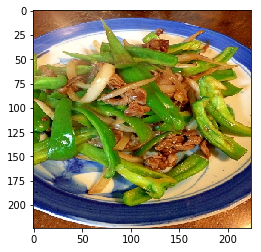

[35  3  1  5 60  0  0  0  0  0  0  0  0  0  0  0]
img 300: ['かぼちゃ', 'ねぎ', 'ゴマ油', 'ズッキーニ', 'トマト', 'パセリ', '塩', '枝豆', '菜種油', '醤油', '黒胡椒']
true : ['こんにゃく', 'ゴマ油', 'トマト', '砂糖', '醤油']
IoU: 0.23076923076923078


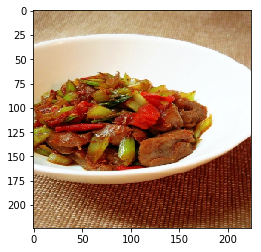

[8 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
img 301: ['こしょう', 'にんじん', 'ねぎ', 'みりん', 'ゴマ油', 'マグロ', '塩', '砂糖', '醤油', '麺つゆ']
true : ['ねぎ']
IoU: 0.1


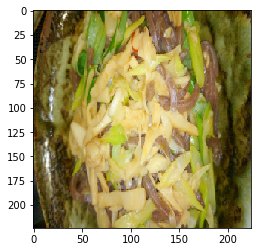

In [15]:
# test
offset=100
preds = model.predict(x_test[offset:])
th = 0.05
for i, (x, y, pred) in enumerate(zip(x_test[offset:], y_test[offset:], preds)):
    indexes = np.where(pred > th)[0]
    words = [detokenizer[idx+1] for idx in indexes]
    print(y)
    true_words = [detokenizer[idx] for idx in y if idx != 0]
    print(f'img {i}: {sorted(words)}')
    print(f'true : {sorted(true_words)}')
    num_i = len(set(words) & set(true_words))
    num_u = len(set(words) | set(true_words))
    print(f'IoU: {num_i / num_u}')
    plt.imshow(x/255.0)
    plt.show()
    print(f'=========================================')
    if i > 300:
        break

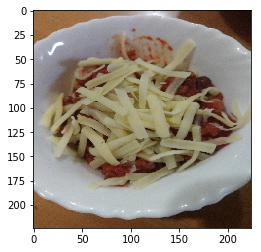

In [16]:
#img = np.asarray(Image.open('/root/userspace/final/P_20200102_192926_vHDR_On.jpg').resize((224,224)))
img = np.asarray(Image.open('/root/userspace/final/P_20200102_192928_vHDR_On.jpg').resize((224,224)))
plt.imshow(img/255)

In [17]:
pred = model.predict(img.reshape(1,224,224,3))
indexes = np.where(pred > 0.3)[1]
print(indexes)
words = [detokenizer[idx+1] for idx in indexes]
print(words)

[ 3  4  5 12 31]
['ニンニク', 'ゴマ油', '塩コショウ', '玉ねぎ', '麺つゆ']
